# The Zucchini in the Seatbelt - Debugging Imagenet Data with TrackIn [![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/frederick0329/TrackIn/blob/master/resnet50_imagenet_self_influence.ipynb)




*   ![Zucchini in the seatbelt](https://user-images.githubusercontent.com/3983652/86094797-db2f6100-ba65-11ea-9c89-e9fc32db9457.jpeg)
*   This colab shows an application of [TrackIn](https://arxiv.org/abs/2002.08484) - Dataset debugging.
*   What we mean by dataset debugging - inspect certain types of outliers in the training data. We will idendify a few categories of outliers (mislabeled, memorized...) in the last section. You should be to adapt the colab to your own model/data.
* There are two different ways to debug a dataset with TrackIn. This colab ranks imagenet examples in training data by self-influence. To understand how self influence work, please refer to [FAQ](https://drive.google.com/file/d/1zL3hwW4wFru49_-zwpmliRDdCahjumXa/view). The premise is that other correctly labelled training points will oppose this point’s incorrect label. 
* With the help of TPUs, it takes around 15 minutes to run over 1.28M imagenet examples.


To Run

*   Runtime -> Change Runtime Type -> TPU

To adapt to your own data/model
  *   Load your own model and select checkpoints. 
  *   Pick weights.
  *   Replace loss function.
  *   Write your own dataset loader.







# Define varaibles

In [39]:
IMAGENET_LABEL_DICT = "imagenet_class_index.json" #@param {type:"string"}
IMAGENET_TFDS_DIR = "tensorflow_datasets" #@param {type:"string"}
IMAGENET_TRAIN = "imagenet/train" #@param {type:"string"}
CHECKPOINTS_PATH_FORMAT = "ckpt{}" #@param {type:"string"}

## Auth if your data is stored on gcs

In [40]:
from google.colab import auth
auth.authenticate_user()  

# Imports and utils

In [41]:
# @title Imports
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.image as mpimg
import io
import json
import numpy as np
import time
import datetime
import functools
import matplotlib.pyplot as plt

In [ ]:
#@title Connect to TPU
try:
  tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
  print('Running on TPU ', tpu.cluster_spec().as_dict()['worker'])
except ValueError:
  raise BaseException('ERROR: Not connected to a TPU runtime; please see the previous cell in this notebook for instructions!')

tf.config.experimental_connect_to_cluster(tpu)
tf.tpu.experimental.initialize_tpu_system(tpu)
strategy = tf.distribute.experimental.TPUStrategy(tpu)

In [43]:
#@title Dataset Utils

def _train_filename2id(filename):
  filename = tf.strings.regex_replace(filename, "n", "")
  filename = tf.strings.regex_replace(filename, ".JPEG", "")
  filename_split = tf.strings.split(filename, "_")
  fileid = tf.strings.to_number(filename_split, tf.int32)
  return fileid

def _val_filename2id(filename):
  filename = tf.strings.regex_replace(filename, "ILSVRC2012_val_", "")
  filename = tf.strings.regex_replace(filename, ".JPEG", "")
  fileid = tf.strings.to_number(filename, tf.int32)
  return fileid  

def _resize_image(image_bytes: tf.Tensor,
                 height: int = 224,
                 width: int = 224) -> tf.Tensor:
  """Resizes an image to a given height and width."""
  return tf.compat.v1.image.resize(
      image_bytes, [height, width], method=tf.image.ResizeMethod.BILINEAR,
      align_corners=False) 

# Calculated from the ImageNet training set
MEAN_RGB = (0.485 * 255, 0.456 * 255, 0.406 * 255)
STDDEV_RGB = (0.229 * 255, 0.224 * 255, 0.225 * 255)

def mean_image_subtraction(
    image_bytes,
    means,
    num_channels = 3,
    dtype = tf.float32,
):
  """Subtracts the given means from each image channel.

  For example:
    means = [123.68, 116.779, 103.939]
    image_bytes = mean_image_subtraction(image_bytes, means)

  Note that the rank of `image` must be known.

  Args:
    image_bytes: a tensor of size [height, width, C].
    means: a C-vector of values to subtract from each channel.
    num_channels: number of color channels in the image that will be distorted.
    dtype: the dtype to convert the images to. Set to `None` to skip conversion.

  Returns:
    the centered image.

  Raises:
    ValueError: If the rank of `image` is unknown, if `image` has a rank other
      than three or if the number of channels in `image` doesn't match the
      number of values in `means`.
  """
  if image_bytes.get_shape().ndims != 3:
    raise ValueError('Input must be of size [height, width, C>0]')

  if len(means) != num_channels:
    raise ValueError('len(means) must match the number of channels')

  # We have a 1-D tensor of means; convert to 3-D.
  # Note(b/130245863): we explicitly call `broadcast` instead of simply
  # expanding dimensions for better performance.
  means = tf.broadcast_to(means, tf.shape(image_bytes))
  if dtype is not None:
    means = tf.cast(means, dtype=dtype)

  return image_bytes - means


def standardize_image(
    image_bytes,
    stddev,
    num_channels = 3,
    dtype = tf.float32,
):
  """Divides the given stddev from each image channel.

  For example:
    stddev = [123.68, 116.779, 103.939]
    image_bytes = standardize_image(image_bytes, stddev)

  Note that the rank of `image` must be known.

  Args:
    image_bytes: a tensor of size [height, width, C].
    stddev: a C-vector of values to divide from each channel.
    num_channels: number of color channels in the image that will be distorted.
    dtype: the dtype to convert the images to. Set to `None` to skip conversion.

  Returns:
    the centered image.

  Raises:
    ValueError: If the rank of `image` is unknown, if `image` has a rank other
      than three or if the number of channels in `image` doesn't match the
      number of values in `stddev`.
  """
  if image_bytes.get_shape().ndims != 3:
    raise ValueError('Input must be of size [height, width, C>0]')

  if len(stddev) != num_channels:
    raise ValueError('len(stddev) must match the number of channels')

  # We have a 1-D tensor of stddev; convert to 3-D.
  # Note(b/130245863): we explicitly call `broadcast` instead of simply
  # expanding dimensions for better performance.
  stddev = tf.broadcast_to(stddev, tf.shape(image_bytes))
  if dtype is not None:
    stddev = tf.cast(stddev, dtype=dtype)

  return image_bytes / stddev   

# TPU does not allow tf.string and images with various size. Therefore, decode 
# and cropping cannot happen in the model.
def _preprocess(inputs, split='train', image_size=224, crop_padding=32):
  """Apply image preprocessing."""
  filename = inputs['file_name']
  image = inputs['image']
  label = inputs['label']
  if split == 'train':
    fileid = _train_filename2id(filename)
  else:      
    fileid = _val_filename2id(filename)
  shape = tf.shape(image)
  image_height = shape[0]
  image_width = shape[1]

  padded_center_crop_size = tf.cast(
      ((image_size / (image_size + crop_padding)) *
       tf.cast(tf.minimum(image_height, image_width), tf.float32)),
      tf.int32)

  offset_height = ((image_height - padded_center_crop_size) + 1) // 2
  offset_width = ((image_width - padded_center_crop_size) + 1) // 2
  crop_window = tf.stack([offset_height, offset_width,
                          padded_center_crop_size, padded_center_crop_size])
  
  image = tf.image.crop_to_bounding_box(
        image,
        offset_height=offset_height,
        offset_width=offset_width,
        target_height=padded_center_crop_size,
        target_width=padded_center_crop_size)
  image = _resize_image(image_bytes=image,
                        height=image_size,
                        width=image_size)
  image = mean_image_subtraction(
        image, MEAN_RGB)
  image = standardize_image(
        image, STDDEV_RGB)

  image = tf.cast(image, tf.float32)
  label = tf.cast(label, tf.int32)
  return fileid, image, label  


def make_get_dataset(split, batch_size):
  def get_dataset(
      input_context: tf.distribute.InputContext = None) -> tf.data.Dataset:
    #builder = tfds.builder('imagenet2012')
    builder = tfds.builder(name='imagenet2012', data_dir=IMAGENET_TFDS_DIR)
    builder.download_and_prepare()

    read_config = tfds.ReadConfig(
        interleave_block_length=1)

    _preprocess_fn = functools.partial(_preprocess, split=split)

    ds = builder.as_dataset(
        split=split,
        as_supervised=False,
        shuffle_files=False,
        read_config=read_config)
    ds = ds.map(_preprocess_fn,
                num_parallel_calls=tf.data.experimental.AUTOTUNE)
    ds = ds.batch(batch_size)

    ds = ds.prefetch(tf.data.experimental.AUTOTUNE)
    return ds
  return get_dataset  

def get_id_synset_mapping():
  with tf.io.gfile.GFile(IMAGENET_LABEL_DICT, "r") as f:
    json_str = f.read()
    index_to_classname = json.loads(json_str)
  return index_to_classname  
index_to_classname = get_id_synset_mapping()  

def get_image(id):
  filepath = '{}/n0{}/n0{}_{}.JPEG'.format(IMAGENET_TRAIN, id[0], id[0], id[1])
  try:   
    with tf.io.gfile.GFile(filepath, "rb") as f:
      jpg_data = f.read()
      image = mpimg.imread(io.BytesIO(jpg_data), format='JPG')  
    print('n0{}_{}.JPEG'.format(id[0], id[1]))  
    return image
  except:
    print('Failed to read image {}'.format(filepath))    

In [44]:
#@title Self Influence Utils

def show_self_influence(trackin_self_influence, topk=50):
  self_influence_scores = trackin_self_influence['self_influences']
  indices = np.argsort(-self_influence_scores)
  for i, index in enumerate(indices[:topk]):
    print('example {} (index: {})'.format(i, index))
    print('label: {}, prob: {}, predicted_label: {}'.format(
        index_to_classname[str(trackin_self_influence['labels'][index])][1], 
        trackin_self_influence['probs'][index][0], 
        index_to_classname[str(trackin_self_influence['predicted_labels'][index][0])][1]))
    img = get_image(trackin_self_influence['image_ids'][index])
    if img is not None:
      plt.imshow(img, interpolation='nearest')
      plt.show()   

# Init models/checkpoints



* Resnet50 - 75.8% accuracy
* Pick 30, 60, 90th checkpoint 
* Model checkpoint weights are converted to saved models so the colab does not depend on model code.



In [46]:
start = time.time()
with strategy.scope():
  models = []
  for i in [30, 60, 90]:
    model = tf.keras.models.load_model(CHECKPOINTS_PATH_FORMAT.format(i))
    models.append(model)
end = time.time()
print(datetime.timedelta(seconds=end - start))    

0:01:15.747072


# Calculating self influence (Around 10 minutes)

*   Pick weights from the last fully connected layer. 



In [47]:
@tf.function
def run_self_influence(inputs):
  imageids, images, labels = inputs
  self_influences = []
  for m in models:
    with tf.GradientTape(watch_accessed_variables=False) as tape:
      tape.watch(m.trainable_weights[-2:])
      probs = m(images)
      loss = tf.keras.losses.sparse_categorical_crossentropy(labels, probs)
    grads = tape.jacobian(loss, m.trainable_weights[-2:])
    scores = tf.add_n([tf.math.reduce_sum(
        grad * grad, axis=tf.range(1, tf.rank(grad), 1)) 
        for grad in grads])
    self_influences.append(scores)  

  # Using probs from last checkpoint
  probs, predicted_labels = tf.math.top_k(probs, k=1)
  return imageids, tf.math.reduce_sum(tf.stack(self_influences, axis=-1), axis=-1), labels, probs, predicted_labels

In [48]:
def get_self_influence(ds):
  image_ids_np = []
  self_influences_np = []
  labels_np = []
  probs_np = []
  predicted_labels_np = []
  for d in ds:
    imageids_replicas, self_influences_replica, labels_replica, probs_replica, predictied_labels_replica = strategy.run(run_self_influence, args=(d,))  
    for imageids, self_influences, labels, probs, predicted_labels in zip(
        strategy.experimental_local_results(imageids_replicas), 
        strategy.experimental_local_results(self_influences_replica), 
        strategy.experimental_local_results(labels_replica), 
        strategy.experimental_local_results(probs_replica), 
        strategy.experimental_local_results(predictied_labels_replica)):
      if imageids.shape[0] == 0:
        continue
      image_ids_np.append(imageids.numpy())
      self_influences_np.append(self_influences.numpy())
      labels_np.append(labels.numpy())
      probs_np.append(probs.numpy())
      predicted_labels_np.append(predicted_labels.numpy()) 
  return {'image_ids': np.concatenate(image_ids_np),
          'self_influences': np.concatenate(self_influences_np),
          'labels': np.concatenate(labels_np),
          'probs': np.concatenate(probs_np),
          'predicted_labels': np.concatenate(predicted_labels_np)
         }    

In [49]:
ds_train = strategy.experimental_distribute_datasets_from_function(make_get_dataset('train', 512))

In [50]:
start = time.time()
trackin_train_self_influences = get_self_influence(ds_train)
end = time.time()
print(datetime.timedelta(seconds=end - start))

0:09:59.372210


example 0 (index: 565341)
label: sombrero, prob: 0.9999185800552368, predicted_label: maraca
n04259630_9159.JPEG


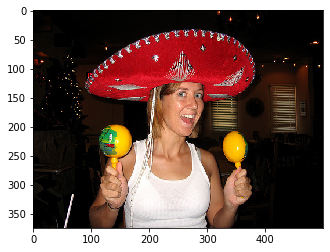

example 1 (index: 166883)
label: tennis_ball, prob: 0.9835540652275085, predicted_label: racket
n04409515_5974.JPEG


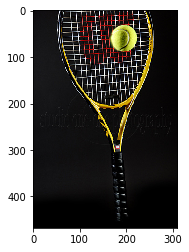

example 2 (index: 13322)
label: barbell, prob: 0.8711369037628174, predicted_label: dumbbell
n02790996_8133.JPEG


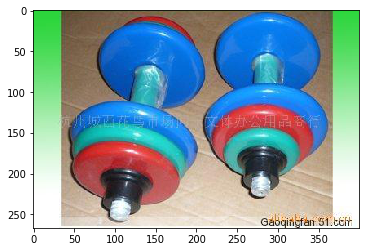

example 3 (index: 522722)
label: hot_pot, prob: 0.9978615641593933, predicted_label: Crock_Pot
n07590611_5192.JPEG


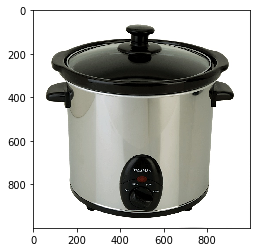

example 4 (index: 395796)
label: barbell, prob: 0.9553051590919495, predicted_label: dumbbell
n02790996_10403.JPEG


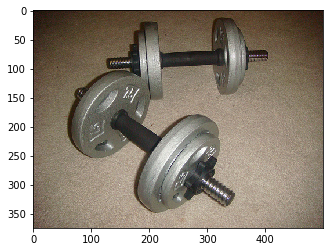

example 5 (index: 589028)
label: barbell, prob: 0.9416490197181702, predicted_label: dumbbell
n02790996_3412.JPEG


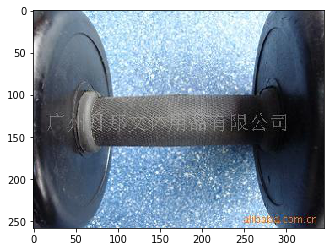

example 6 (index: 997442)
label: Appenzeller, prob: 0.9167525768280029, predicted_label: EntleBucher
n02107908_11730.JPEG


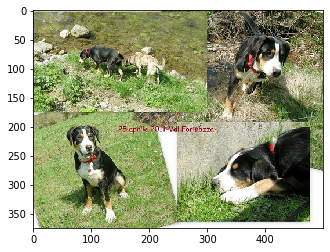

example 7 (index: 984162)
label: neck_brace, prob: 1.0, predicted_label: crutch
n03814639_5972.JPEG


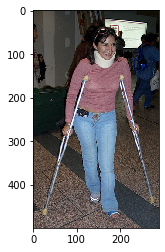

example 8 (index: 680388)
label: binder, prob: 0.8719987273216248, predicted_label: carton
n02840245_3965.JPEG


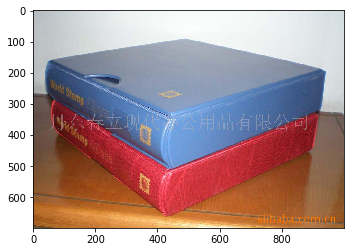

example 9 (index: 1260164)
label: chime, prob: 0.9995189905166626, predicted_label: birdhouse
n03017168_23168.JPEG


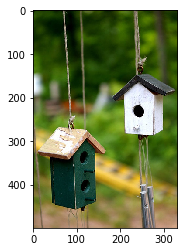

example 10 (index: 1037049)
label: ping-pong_ball, prob: 0.9363496899604797, predicted_label: rubber_eraser
n03942813_2956.JPEG


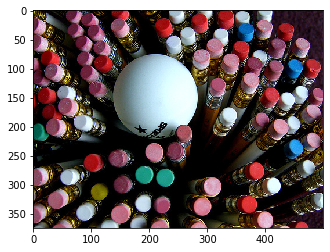

example 11 (index: 964570)
label: Great_Dane, prob: 0.9833388328552246, predicted_label: bull_mastiff
n02109047_3550.JPEG


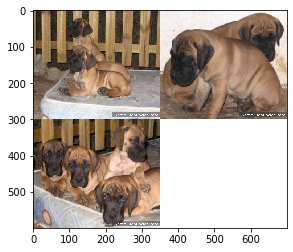

example 12 (index: 544593)
label: mongoose, prob: 0.8935487866401672, predicted_label: meerkat
n02137549_7265.JPEG


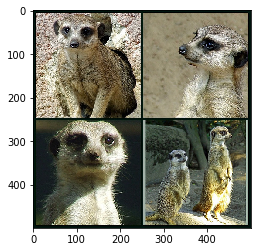

example 13 (index: 1029275)
label: hen, prob: 0.9408406615257263, predicted_label: cock
n01514859_12756.JPEG


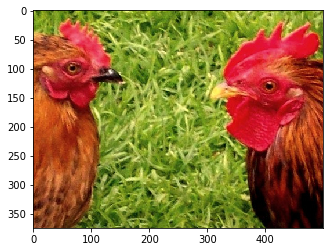

example 14 (index: 63641)
label: grocery_store, prob: 0.999822199344635, predicted_label: butcher_shop
n03461385_57246.JPEG


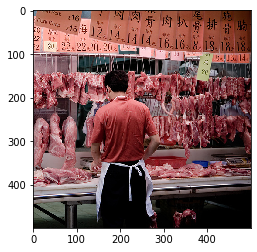

example 15 (index: 1156355)
label: titi, prob: 0.9604848027229309, predicted_label: marmoset
n02493509_16038.JPEG


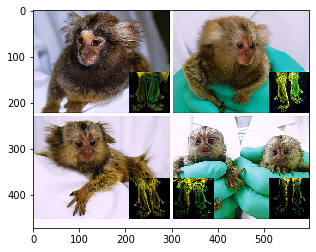

example 16 (index: 1227921)
label: screwdriver, prob: 0.9522096514701843, predicted_label: carpenter's_kit
n04154565_33621.JPEG


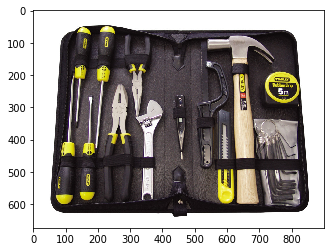

example 17 (index: 162394)
label: nail, prob: 0.9275648593902588, predicted_label: screw
n03804744_6838.JPEG


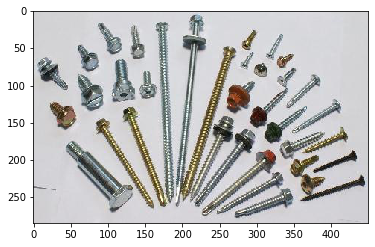

example 18 (index: 1257863)
label: measuring_cup, prob: 0.9361953139305115, predicted_label: beaker
n03733805_19873.JPEG


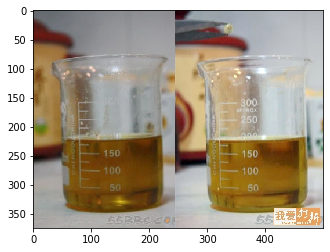

example 19 (index: 596864)
label: ladle, prob: 0.9562690854072571, predicted_label: wooden_spoon
n03633091_16462.JPEG


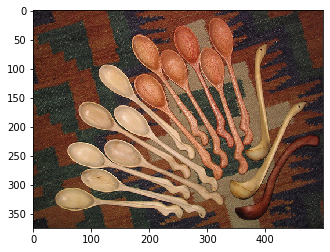

example 20 (index: 516726)
label: barbell, prob: 0.9135143756866455, predicted_label: dumbbell
n02790996_481.JPEG


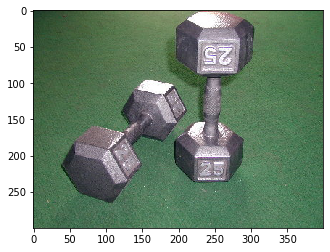

example 21 (index: 268811)
label: chain, prob: 0.9079257845878601, predicted_label: chain_mail
n02999410_44836.JPEG


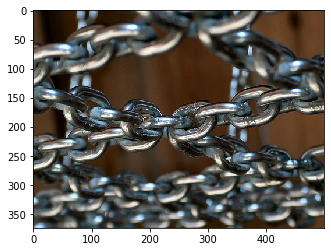

example 22 (index: 1095790)
label: barbell, prob: 0.9507935047149658, predicted_label: dumbbell
n02790996_1486.JPEG


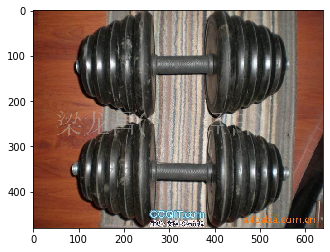

example 23 (index: 709662)
label: digital_watch, prob: 0.9596629738807678, predicted_label: digital_clock
n03197337_1226.JPEG


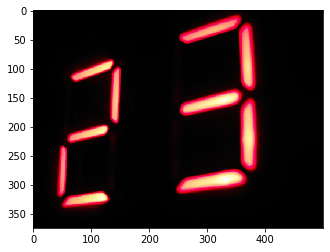

example 24 (index: 287984)
label: harmonica, prob: 0.4640739858150482, predicted_label: can_opener
n03494278_46427.JPEG


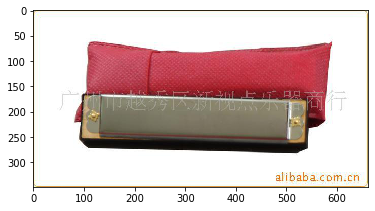

example 25 (index: 340301)
label: measuring_cup, prob: 0.8972063064575195, predicted_label: beaker
n03733805_820.JPEG


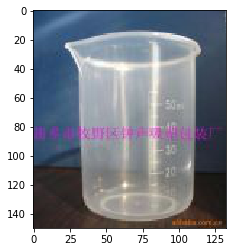

example 26 (index: 20481)
label: rubber_eraser, prob: 0.9382873177528381, predicted_label: lipstick
n04116512_8643.JPEG


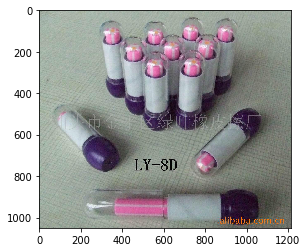

example 27 (index: 281933)
label: hammer, prob: 0.962608814239502, predicted_label: shovel
n03481172_30199.JPEG


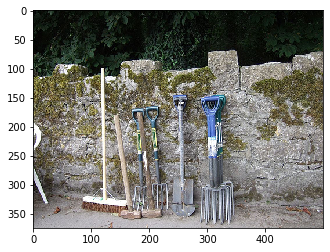

example 28 (index: 1216958)
label: honeycomb, prob: 0.8303448557853699, predicted_label: apiary
n03530642_8337.JPEG


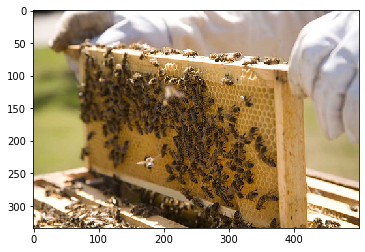

example 29 (index: 1178305)
label: dial_telephone, prob: 0.9904965162277222, predicted_label: pay-phone
n03187595_6987.JPEG


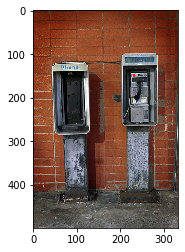

example 30 (index: 44332)
label: thimble, prob: 0.9117907285690308, predicted_label: bottlecap
n04423845_19437.JPEG


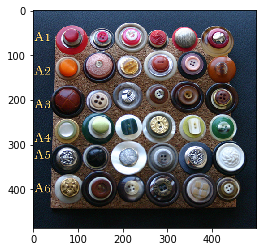

example 31 (index: 110214)
label: oscilloscope, prob: 0.9982278943061829, predicted_label: oscilloscope
n03857828_65294.JPEG


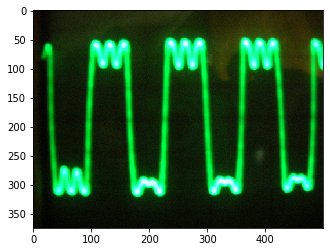

example 32 (index: 1105618)
label: Sealyham_terrier, prob: 0.9947390556335449, predicted_label: Scotch_terrier
n02095889_7625.JPEG


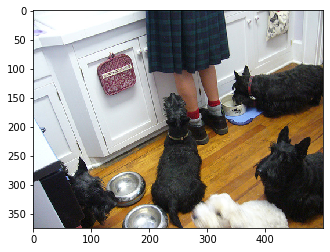

example 33 (index: 1196652)
label: Windsor_tie, prob: 0.9884054064750671, predicted_label: bow_tie
n04591157_3423.JPEG


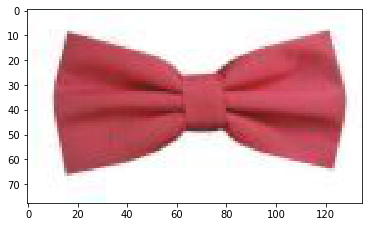

example 34 (index: 531437)
label: shoe_shop, prob: 0.9813509583473206, predicted_label: clog
n04200800_29523.JPEG


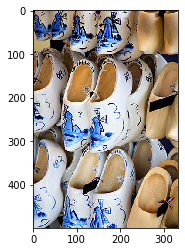

example 35 (index: 142803)
label: pencil_sharpener, prob: 0.5627953410148621, predicted_label: saltshaker
n03908714_6469.JPEG


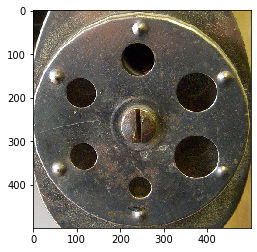

example 36 (index: 365376)
label: barbell, prob: 0.552767813205719, predicted_label: shopping_basket
n02790996_612.JPEG


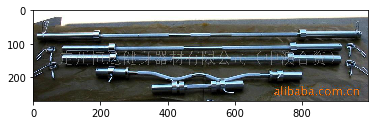

example 37 (index: 389414)
label: mountain_bike, prob: 0.9958136677742004, predicted_label: disk_brake
n03792782_8062.JPEG


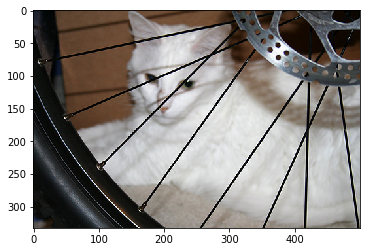

example 38 (index: 1090318)
label: grand_piano, prob: 0.9773904085159302, predicted_label: upright
n03452741_2624.JPEG


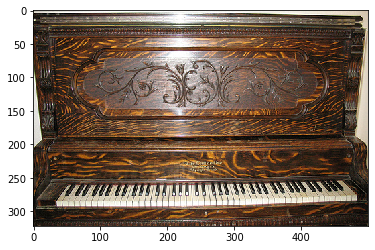

example 39 (index: 138737)
label: chain, prob: 0.9206253886222839, predicted_label: chain_mail
n02999410_15357.JPEG


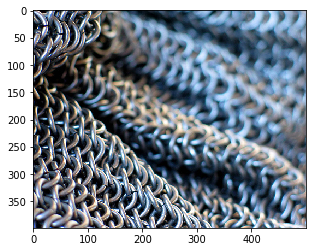

example 40 (index: 760757)
label: pier, prob: 0.9992431402206421, predicted_label: sea_lion
n03933933_21771.JPEG


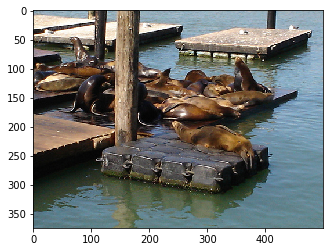

example 41 (index: 337173)
label: hen, prob: 0.974966824054718, predicted_label: cock
n01514859_6111.JPEG


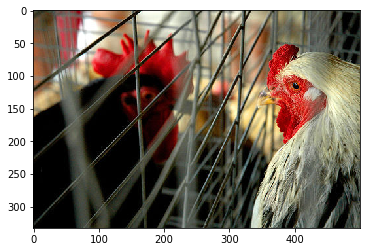

example 42 (index: 792642)
label: Eskimo_dog, prob: 0.9535504579544067, predicted_label: dogsled
n02109961_30822.JPEG


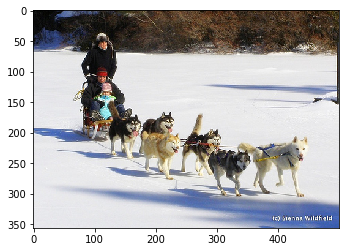

example 43 (index: 334992)
label: barbershop, prob: 0.897308886051178, predicted_label: barber_chair
n02791270_27288.JPEG


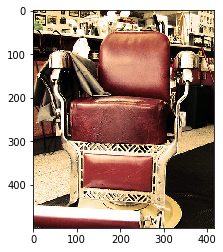

example 44 (index: 256443)
label: gazelle, prob: 0.904496967792511, predicted_label: impala
n02423022_5073.JPEG


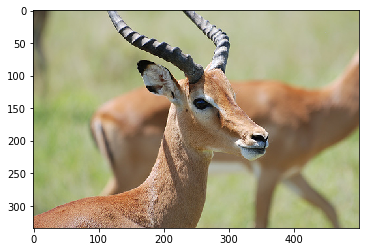

example 45 (index: 1261417)
label: mortarboard, prob: 0.9509409666061401, predicted_label: academic_gown
n03787032_6194.JPEG


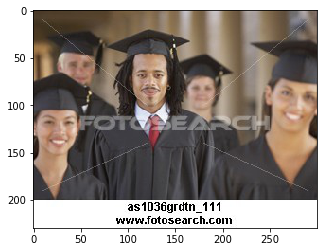

example 46 (index: 806442)
label: honeycomb, prob: 0.995826244354248, predicted_label: apiary
n03530642_39924.JPEG


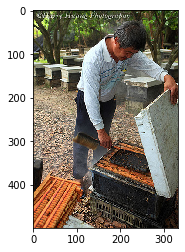

example 47 (index: 905849)
label: worm_fence, prob: 0.6532730460166931, predicted_label: orangutan
n04604644_8026.JPEG


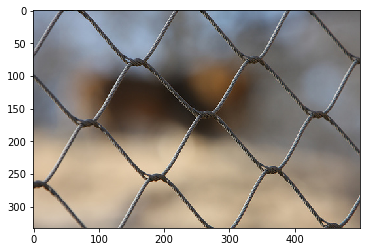

example 48 (index: 76866)
label: oystercatcher, prob: 0.5227219462394714, predicted_label: red-backed_sandpiper
n02037110_27937.JPEG


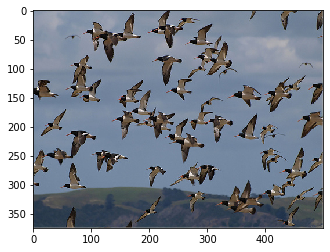

example 49 (index: 677599)
label: barbell, prob: 0.8975867629051208, predicted_label: dumbbell
n02790996_16578.JPEG


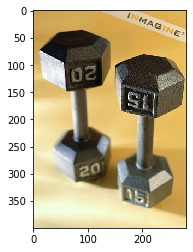

example 50 (index: 143881)
label: skunk, prob: 0.9999909400939941, predicted_label: colobus
n02445715_1220.JPEG


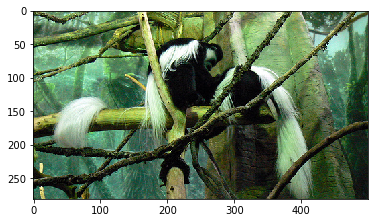

example 51 (index: 795724)
label: grocery_store, prob: 0.9883050322532654, predicted_label: Dungeness_crab
n03461385_27537.JPEG


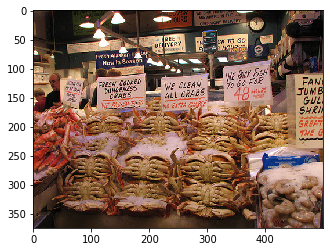

example 52 (index: 497193)
label: barbell, prob: 0.6993896961212158, predicted_label: dumbbell
n02790996_6377.JPEG


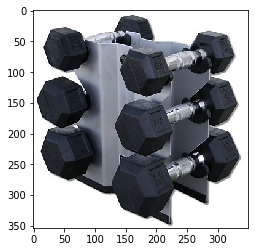

example 53 (index: 957346)
label: sax, prob: 0.8261334300041199, predicted_label: oboe
n04141076_36725.JPEG


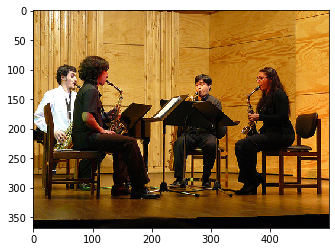

example 54 (index: 686455)
label: hare, prob: 0.9931426048278809, predicted_label: wood_rabbit
n02326432_14566.JPEG


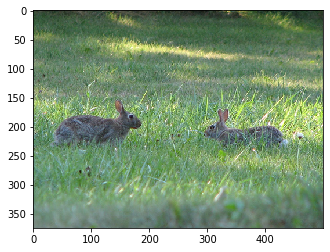

example 55 (index: 544854)
label: soap_dispenser, prob: 0.9760529398918152, predicted_label: perfume
n04254120_5158.JPEG


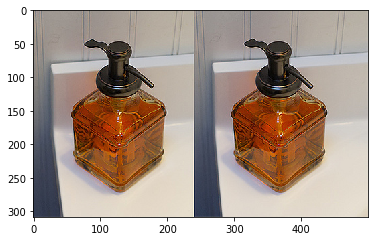

example 56 (index: 522078)
label: box_turtle, prob: 0.44225722551345825, predicted_label: terrapin
n01669191_10578.JPEG


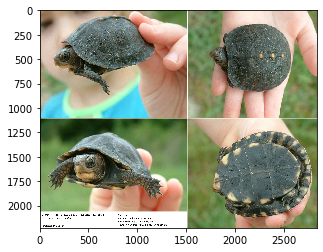

example 57 (index: 47100)
label: wok, prob: 0.8372339010238647, predicted_label: frying_pan
n04596742_26492.JPEG


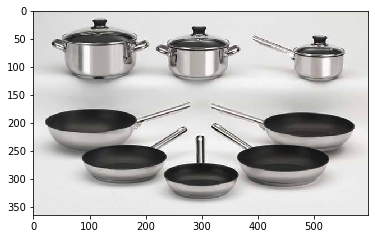

example 58 (index: 36415)
label: mixing_bowl, prob: 0.9555558562278748, predicted_label: chocolate_sauce
n03775546_8758.JPEG


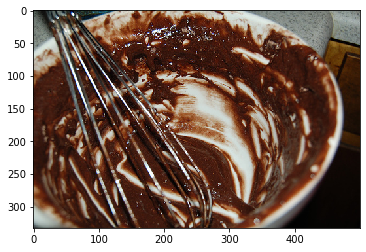

example 59 (index: 637923)
label: barbell, prob: 0.8781728148460388, predicted_label: dumbbell
n02790996_5209.JPEG


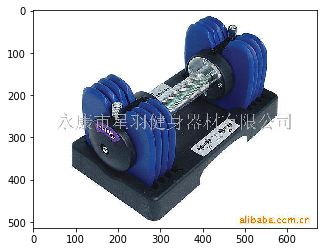

example 60 (index: 420980)
label: pretzel, prob: 0.6207984685897827, predicted_label: bottlecap
n07695742_197.JPEG


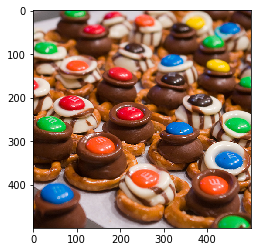

example 61 (index: 642167)
label: ringlet, prob: 0.992321252822876, predicted_label: admiral
n02277742_291.JPEG


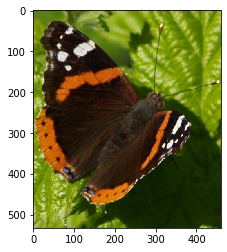

example 62 (index: 1217918)
label: rock_python, prob: 0.9728814363479614, predicted_label: boa_constrictor
n01744401_376.JPEG


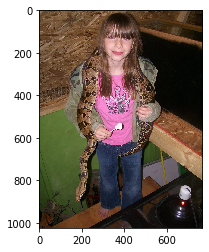

example 63 (index: 558752)
label: Eskimo_dog, prob: 0.9565002918243408, predicted_label: dogsled
n02109961_8270.JPEG


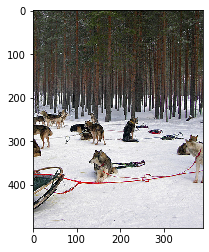

example 64 (index: 550422)
label: sulphur-crested_cockatoo, prob: 0.5975479483604431, predicted_label: red-backed_sandpiper
n01819313_8151.JPEG


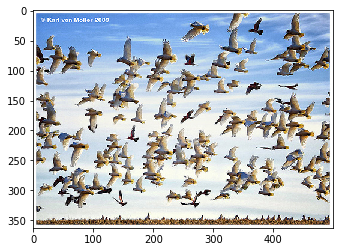

example 65 (index: 875493)
label: pop_bottle, prob: 0.9899942278862, predicted_label: bottlecap
n03983396_644.JPEG


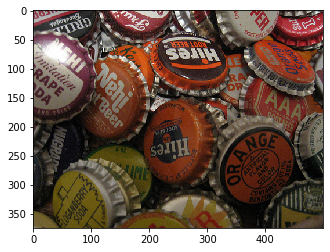

example 66 (index: 741150)
label: shopping_basket, prob: 0.9756473302841187, predicted_label: shopping_cart
n04204238_3980.JPEG


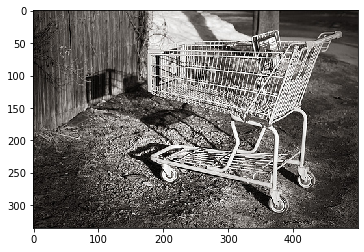

example 67 (index: 708737)
label: burrito, prob: 0.9998897314071655, predicted_label: guacamole
n07880968_2002.JPEG


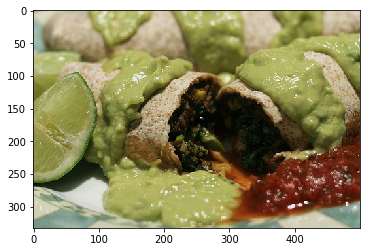

example 68 (index: 135967)
label: lion, prob: 0.9992353916168213, predicted_label: cougar
n02129165_13355.JPEG


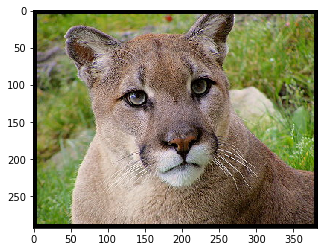

example 69 (index: 1112903)
label: safe, prob: 0.9404823184013367, predicted_label: combination_lock
n04125021_9133.JPEG


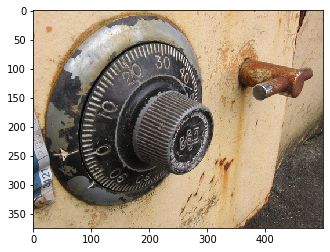

example 70 (index: 403483)
label: plunger, prob: 0.6741118431091309, predicted_label: ballpoint
n03970156_29137.JPEG


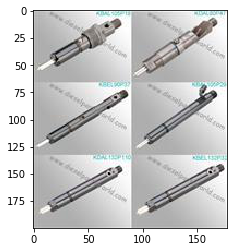

example 71 (index: 695119)
label: cassette_player, prob: 0.9886559844017029, predicted_label: CD_player
n02979186_70.JPEG


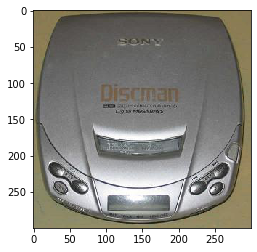

example 72 (index: 896501)
label: ping-pong_ball, prob: 0.9995633959770203, predicted_label: golf_ball
n03942813_2229.JPEG


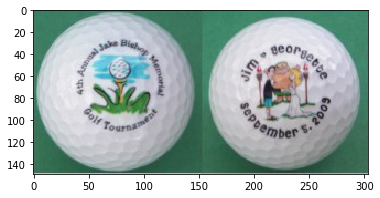

example 73 (index: 505774)
label: shoe_shop, prob: 0.9179577827453613, predicted_label: clog
n04200800_13519.JPEG


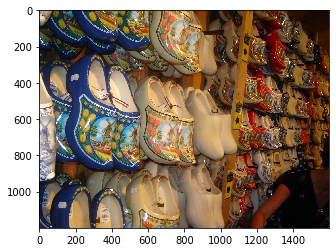

example 74 (index: 420254)
label: breastplate, prob: 0.7851025462150574, predicted_label: cuirass
n02895154_30079.JPEG


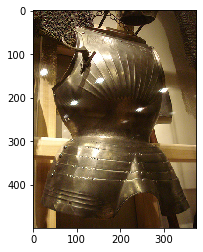

example 75 (index: 932366)
label: bell_cote, prob: 0.9958229064941406, predicted_label: chime
n02825657_5122.JPEG


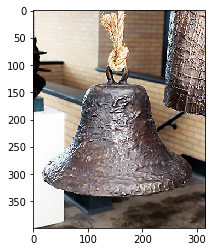

example 76 (index: 207880)
label: hen, prob: 0.9530238509178162, predicted_label: cock
n01514859_10959.JPEG


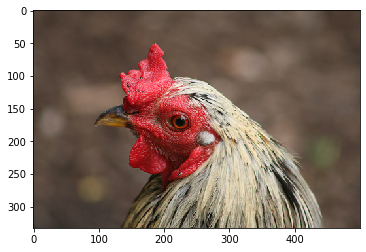

example 77 (index: 104478)
label: cassette_player, prob: 0.9688120484352112, predicted_label: cassette
n02979186_11670.JPEG


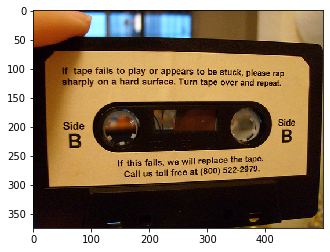

example 78 (index: 1249937)
label: lumbermill, prob: 0.9997597336769104, predicted_label: chain_saw
n03697007_16217.JPEG


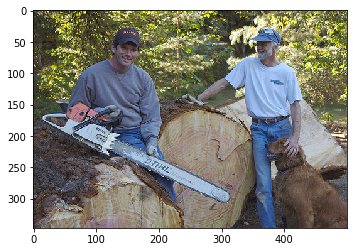

example 79 (index: 886279)
label: espresso, prob: 0.9786068797111511, predicted_label: espresso_maker
n07920052_6380.JPEG


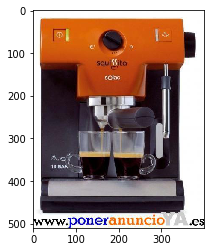

example 80 (index: 456508)
label: shopping_basket, prob: 0.9666053652763367, predicted_label: shopping_cart
n04204238_1806.JPEG


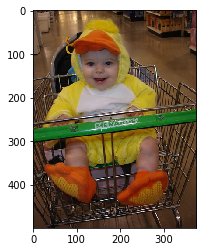

example 81 (index: 969884)
label: plastic_bag, prob: 0.968725860118866, predicted_label: tile_roof
n03958227_9211.JPEG


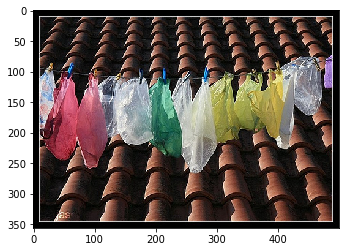

example 82 (index: 119536)
label: mask, prob: 0.9975152015686035, predicted_label: gasmask
n03724870_48653.JPEG


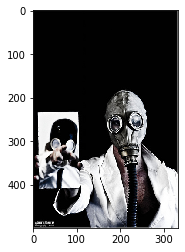

example 83 (index: 734912)
label: digital_watch, prob: 0.9791127443313599, predicted_label: CD_player
n03197337_2252.JPEG


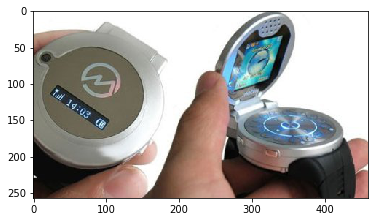

example 84 (index: 938351)
label: forklift, prob: 0.9336602091789246, predicted_label: barrel
n03384352_181.JPEG


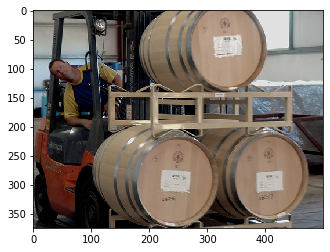

example 85 (index: 991229)
label: maillot, prob: 0.8693749308586121, predicted_label: jersey
n03710637_4966.JPEG


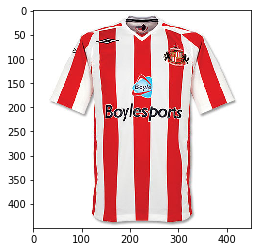

example 86 (index: 1277541)
label: clog, prob: 0.9941365718841553, predicted_label: clog
n03047690_40499.JPEG


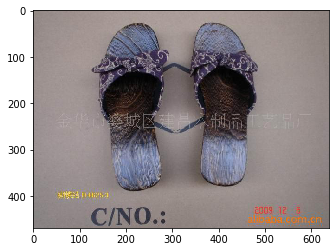

example 87 (index: 248816)
label: analog_clock, prob: 0.9575722813606262, predicted_label: wall_clock
n02708093_4798.JPEG


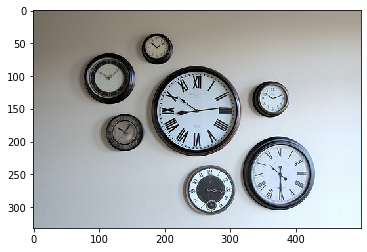

example 88 (index: 1051431)
label: shopping_basket, prob: 0.9841701984405518, predicted_label: shopping_cart
n04204238_13480.JPEG


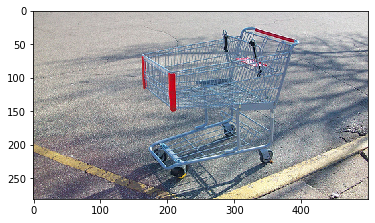

example 89 (index: 1102374)
label: wig, prob: 0.9812166094779968, predicted_label: feather_boa
n04584207_21723.JPEG


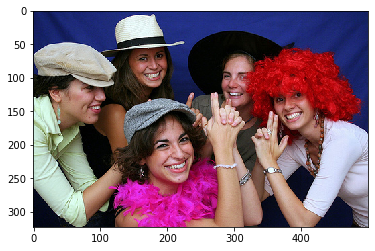

example 90 (index: 457913)
label: sunscreen, prob: 0.92268306016922, predicted_label: lotion
n04357314_18041.JPEG


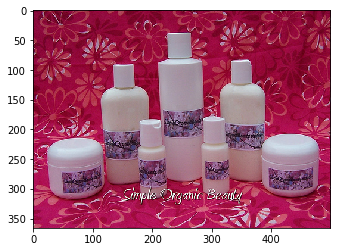

example 91 (index: 243638)
label: bow_tie, prob: 0.9996949434280396, predicted_label: pool_table
n02883205_5696.JPEG


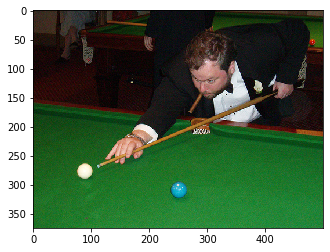

example 92 (index: 298130)
label: maraca, prob: 0.43909645080566406, predicted_label: custard_apple
n03720891_8051.JPEG


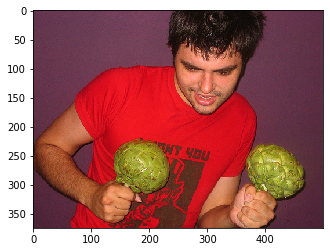

example 93 (index: 917737)
label: paintbrush, prob: 0.9982690811157227, predicted_label: face_powder
n03876231_34235.JPEG


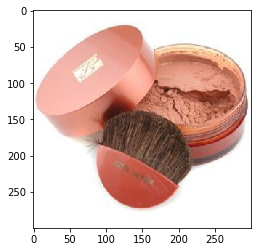

example 94 (index: 222312)
label: strainer, prob: 0.8360530138015747, predicted_label: dumbbell
n04332243_13343.JPEG


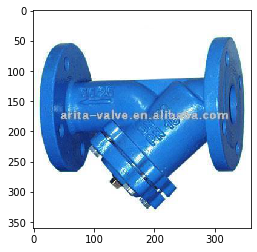

example 95 (index: 126460)
label: cheetah, prob: 0.8258435726165771, predicted_label: jaguar
n02130308_1047.JPEG


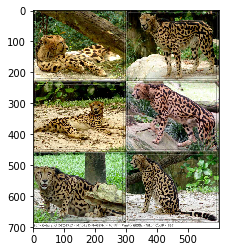

example 96 (index: 859334)
label: caldron, prob: 0.9777336716651917, predicted_label: Dutch_oven
n02939185_43284.JPEG


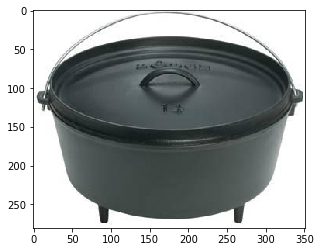

example 97 (index: 278159)
label: cucumber, prob: 0.9651945233345032, predicted_label: zucchini
n07718472_30243.JPEG


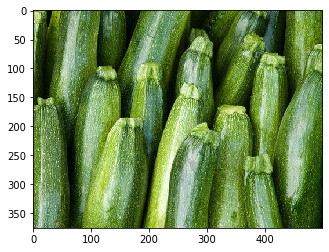

example 98 (index: 749484)
label: electric_guitar, prob: 0.7080692648887634, predicted_label: acoustic_guitar
n03272010_6465.JPEG


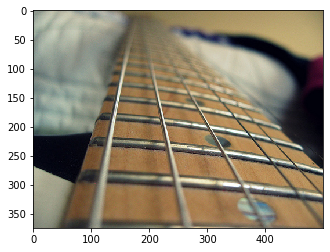

example 99 (index: 834181)
label: pole, prob: 0.8557668328285217, predicted_label: totem_pole
n03976657_24770.JPEG


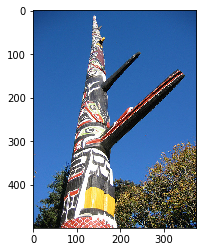

example 100 (index: 165105)
label: coyote, prob: 0.5720102787017822, predicted_label: red_fox
n02114855_8274.JPEG


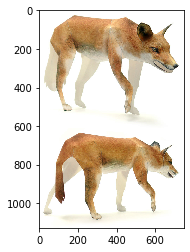

example 101 (index: 1119296)
label: barbell, prob: 0.9787551164627075, predicted_label: dumbbell
n02790996_3855.JPEG


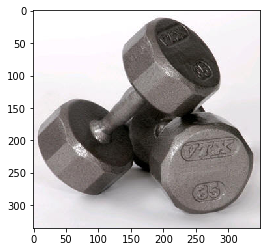

example 102 (index: 624250)
label: digital_watch, prob: 0.9935778379440308, predicted_label: digital_clock
n03197337_2276.JPEG


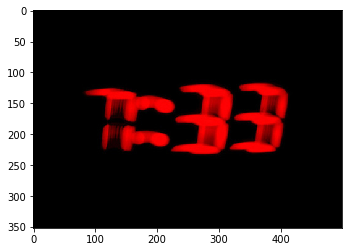

example 103 (index: 264955)
label: reflex_camera, prob: 0.9999794960021973, predicted_label: Polaroid_camera
n04069434_4949.JPEG


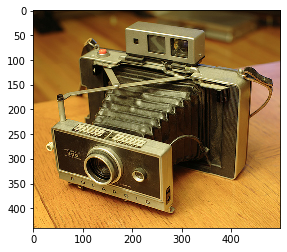

example 104 (index: 473062)
label: digital_watch, prob: 0.9867547750473022, predicted_label: stopwatch
n03197337_20910.JPEG


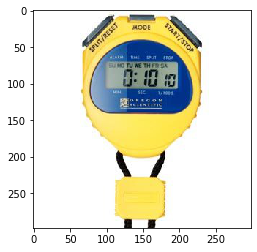

example 105 (index: 267432)
label: bottlecap, prob: 0.9507697224617004, predicted_label: water_bottle
n02877765_12369.JPEG


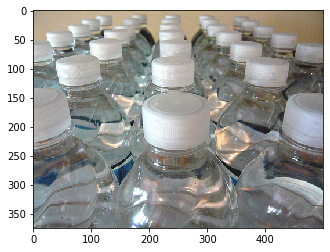

example 106 (index: 1231494)
label: barn_spider, prob: 0.9923936724662781, predicted_label: tick
n01773549_9535.JPEG


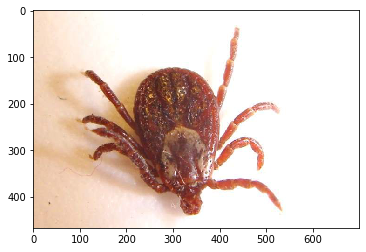

example 107 (index: 1026422)
label: nail, prob: 0.8287222385406494, predicted_label: screw
n03804744_39605.JPEG


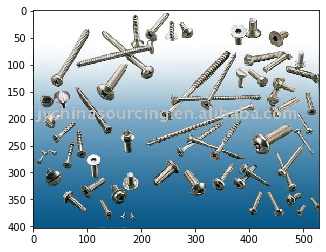

example 108 (index: 705540)
label: chime, prob: 0.9186132550239563, predicted_label: gong
n03017168_30924.JPEG


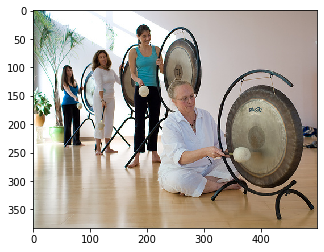

example 109 (index: 144949)
label: zucchini, prob: 0.993617832660675, predicted_label: cucumber
n07716358_20716.JPEG


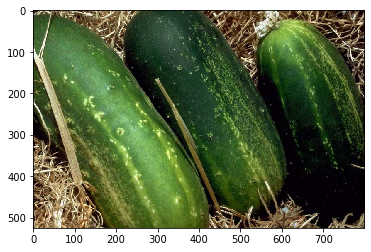

example 110 (index: 797985)
label: radiator, prob: 0.701377272605896, predicted_label: grille
n04040759_5610.JPEG


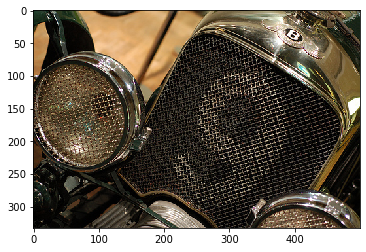

example 111 (index: 586141)
label: coucal, prob: 0.6846222877502441, predicted_label: bee_eater
n01824575_9925.JPEG


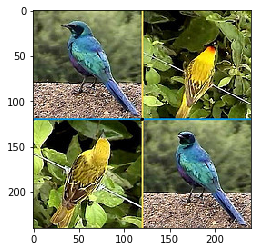

example 112 (index: 90912)
label: red_wine, prob: 0.8807960748672485, predicted_label: wine_bottle
n07892512_1177.JPEG


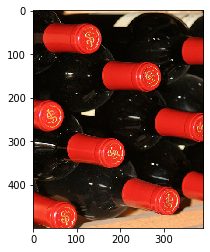

example 113 (index: 357348)
label: hartebeest, prob: 0.7627074718475342, predicted_label: impala
n02422106_617.JPEG


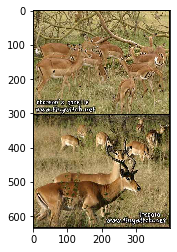

example 114 (index: 300738)
label: bottlecap, prob: 0.9573075175285339, predicted_label: wine_bottle
n02877765_12431.JPEG


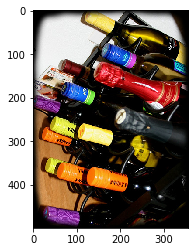

example 115 (index: 228472)
label: theater_curtain, prob: 0.8715865612030029, predicted_label: home_theater
n04418357_26765.JPEG


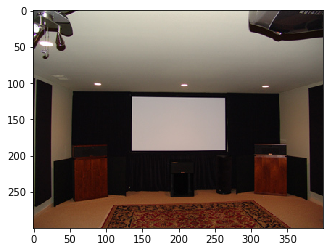

example 116 (index: 994985)
label: lipstick, prob: 0.7855666279792786, predicted_label: face_powder
n03676483_7721.JPEG


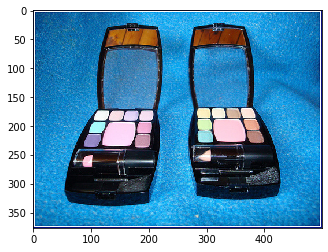

example 117 (index: 420148)
label: Irish_setter, prob: 0.9607287645339966, predicted_label: English_setter
n02100877_22368.JPEG


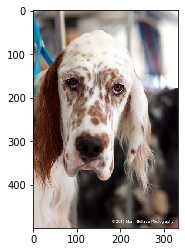

example 118 (index: 918320)
label: mantis, prob: 0.9357680082321167, predicted_label: window_screen
n02236044_2304.JPEG


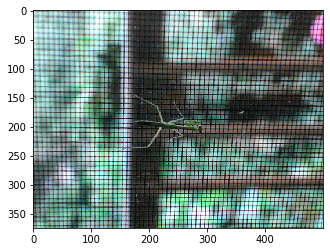

example 119 (index: 620085)
label: pole, prob: 0.9951033592224121, predicted_label: totem_pole
n03976657_5399.JPEG


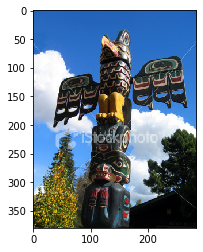

example 120 (index: 662915)
label: dragonfly, prob: 0.30589184165000916, predicted_label: broom
n02268443_24422.JPEG


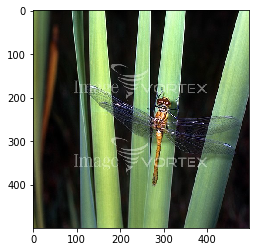

example 121 (index: 486575)
label: wolf_spider, prob: 0.4820341467857361, predicted_label: barn_spider
n01775062_4176.JPEG


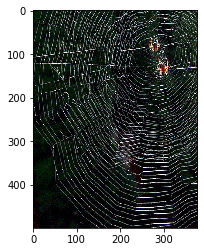

example 122 (index: 875783)
label: screen, prob: 0.9998979568481445, predicted_label: television
n04152593_3561.JPEG


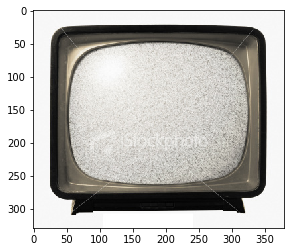

example 123 (index: 250731)
label: soup_bowl, prob: 0.9456193447113037, predicted_label: mixing_bowl
n04263257_2670.JPEG


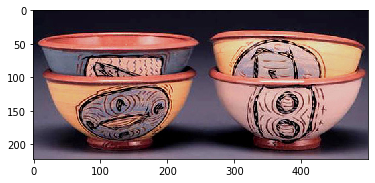

example 124 (index: 793320)
label: ashcan, prob: 0.9894912242889404, predicted_label: crate
n02747177_23474.JPEG


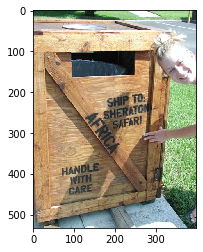

example 125 (index: 252116)
label: cello, prob: 0.9417822360992432, predicted_label: violin
n02992211_26961.JPEG


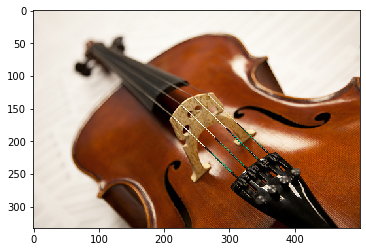

example 126 (index: 300627)
label: mink, prob: 0.8985976576805115, predicted_label: black-footed_ferret
n02442845_8984.JPEG


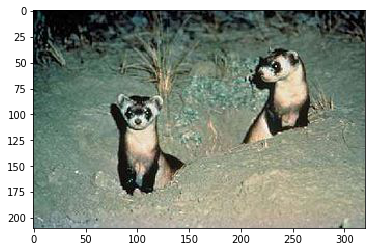

example 127 (index: 1082289)
label: boathouse, prob: 0.7480098009109497, predicted_label: barn
n02859443_14635.JPEG


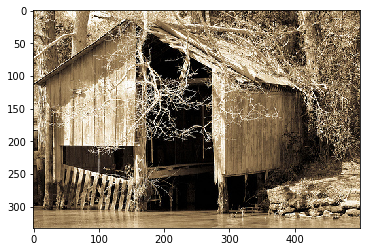

example 128 (index: 1092921)
label: barbell, prob: 0.7385026216506958, predicted_label: dumbbell
n02790996_9255.JPEG


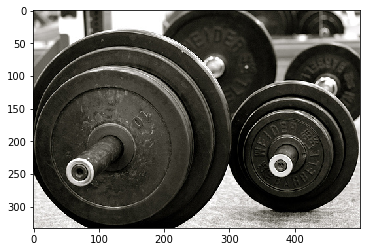

example 129 (index: 1236342)
label: screen, prob: 0.9787116050720215, predicted_label: oscilloscope
n04152593_1507.JPEG


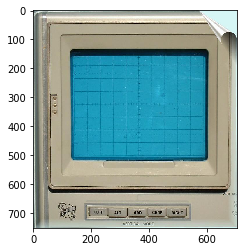

example 130 (index: 829074)
label: sock, prob: 0.9993984699249268, predicted_label: running_shoe
n04254777_16963.JPEG


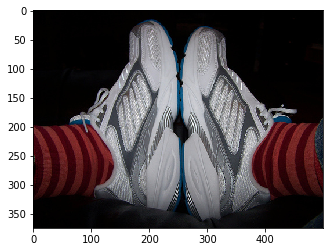

example 131 (index: 1048271)
label: pick, prob: 0.9539122581481934, predicted_label: acoustic_guitar
n03929660_84721.JPEG


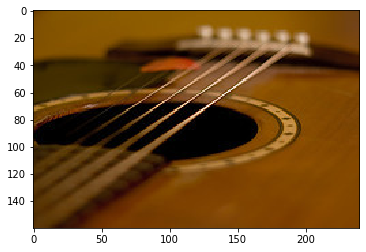

example 132 (index: 45239)
label: African_crocodile, prob: 0.983978807926178, predicted_label: American_alligator
n01697457_913.JPEG


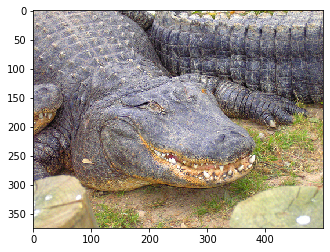

example 133 (index: 785876)
label: barbell, prob: 0.6813904643058777, predicted_label: dumbbell
n02790996_573.JPEG


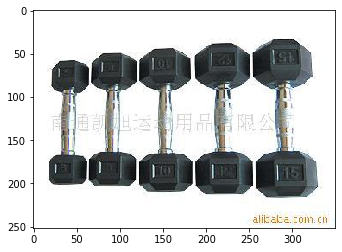

example 134 (index: 711889)
label: upright, prob: 0.9994722008705139, predicted_label: grand_piano
n04515003_1567.JPEG


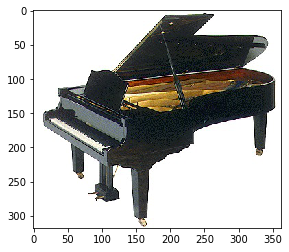

example 135 (index: 124384)
label: Siberian_husky, prob: 0.4319750964641571, predicted_label: Eskimo_dog
n02110185_3523.JPEG


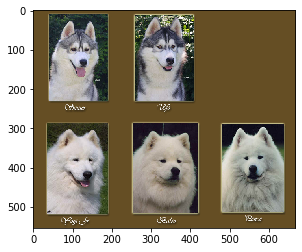

example 136 (index: 229997)
label: nail, prob: 0.938639760017395, predicted_label: screw
n03804744_26659.JPEG


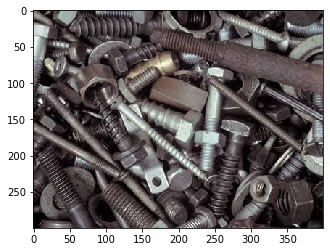

example 137 (index: 752944)
label: dial_telephone, prob: 0.9938757419586182, predicted_label: pay-phone
n03187595_17111.JPEG


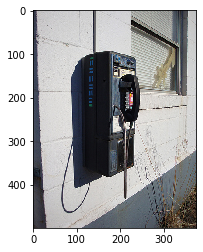

example 138 (index: 538806)
label: gong, prob: 0.9839696288108826, predicted_label: chime
n03447721_32609.JPEG


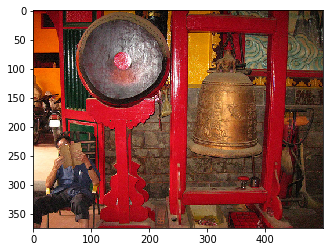

example 139 (index: 1120172)
label: spider_monkey, prob: 0.9555968046188354, predicted_label: squirrel_monkey
n02493793_6160.JPEG


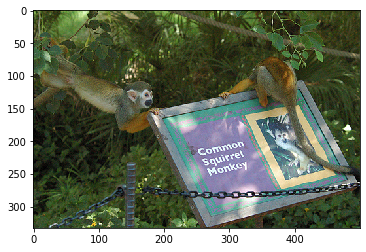

example 140 (index: 496037)
label: revolver, prob: 0.854719877243042, predicted_label: screwdriver
n04086273_38146.JPEG


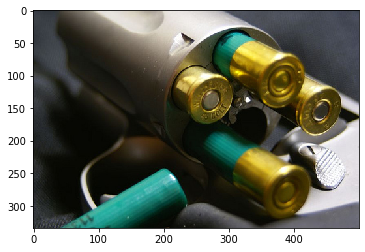

example 141 (index: 235068)
label: combination_lock, prob: 0.9988804459571838, predicted_label: safe
n03075370_10307.JPEG


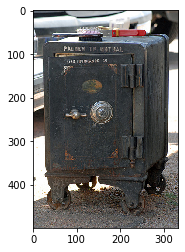

example 142 (index: 625312)
label: rock_crab, prob: 0.9500963687896729, predicted_label: king_crab
n01978455_7445.JPEG


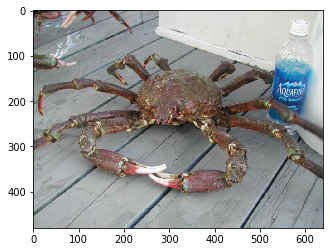

example 143 (index: 137078)
label: grand_piano, prob: 0.9151510000228882, predicted_label: upright
n03452741_22581.JPEG


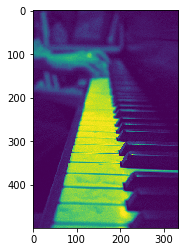

example 144 (index: 647240)
label: panpipe, prob: 0.8249607086181641, predicted_label: flute
n03884397_24837.JPEG


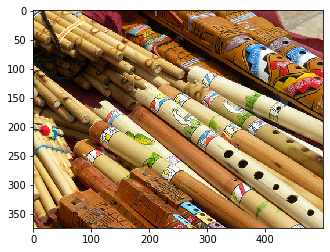

example 145 (index: 44285)
label: grocery_store, prob: 0.9429150819778442, predicted_label: Dungeness_crab
n03461385_3131.JPEG


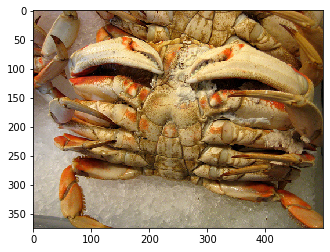

example 146 (index: 804811)
label: beer_bottle, prob: 0.6900019645690918, predicted_label: water_bottle
n02823428_1314.JPEG


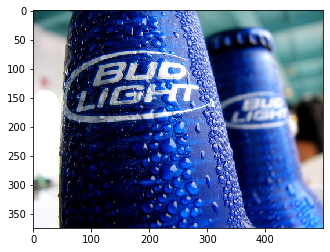

example 147 (index: 262078)
label: tennis_ball, prob: 0.924476146697998, predicted_label: racket
n04409515_2859.JPEG


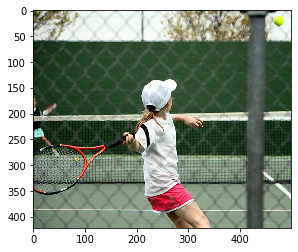

example 148 (index: 584286)
label: bottlecap, prob: 0.94528728723526, predicted_label: rugby_ball
n02877765_2092.JPEG


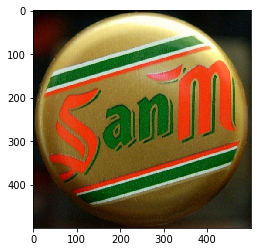

example 149 (index: 641458)
label: screwdriver, prob: 0.7605183720588684, predicted_label: lipstick
n04154565_11822.JPEG


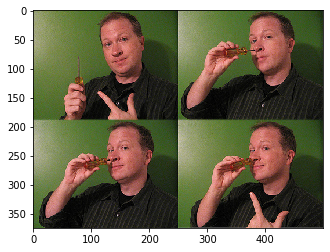

example 150 (index: 87535)
label: acorn, prob: 0.5657221674919128, predicted_label: web_site
Failed to read image gs://costine-test-bucket/data/imagenet/train/n012267677/n012267677_10153.JPEG
example 151 (index: 181115)
label: chain, prob: 0.7191668748855591, predicted_label: necklace
n02999410_876.JPEG


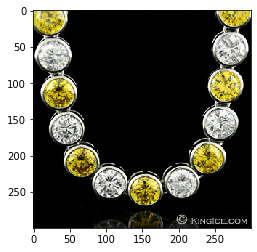

example 152 (index: 251729)
label: wooden_spoon, prob: 0.9767407774925232, predicted_label: spatula
n04597913_837.JPEG


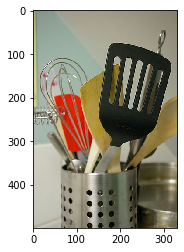

example 153 (index: 48514)
label: ballpoint, prob: 0.20055700838565826, predicted_label: swab
n02783161_6085.JPEG


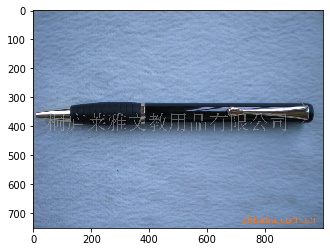

example 154 (index: 915)
label: Eskimo_dog, prob: 0.9251880645751953, predicted_label: dogsled
n02109961_14202.JPEG


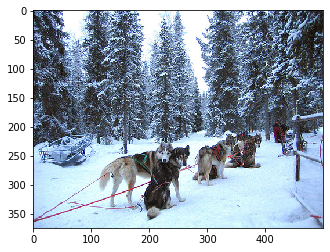

example 155 (index: 1243225)
label: Irish_wolfhound, prob: 0.9717143774032593, predicted_label: Scottish_deerhound
n02090721_5265.JPEG


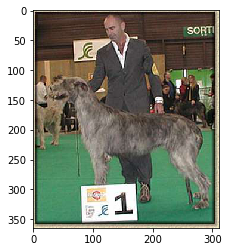

example 156 (index: 944193)
label: hook, prob: 0.9313238859176636, predicted_label: necklace
n03532672_37033.JPEG


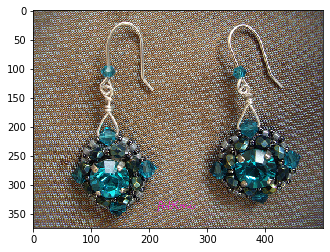

example 157 (index: 581152)
label: titi, prob: 0.9964142441749573, predicted_label: patas
n02493509_1549.JPEG


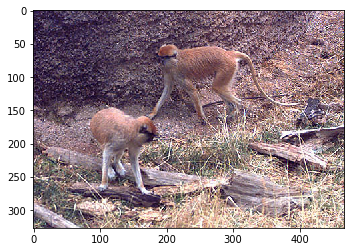

example 158 (index: 110696)
label: broom, prob: 0.48540234565734863, predicted_label: dumbbell
n02906734_7411.JPEG


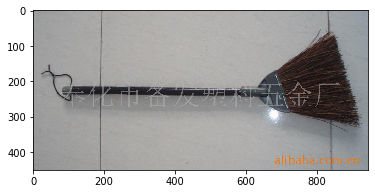

example 159 (index: 854972)
label: measuring_cup, prob: 0.9984869360923767, predicted_label: beaker
n03733805_12683.JPEG


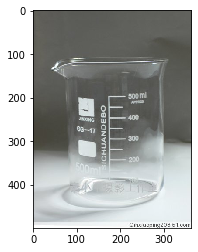

example 160 (index: 570040)
label: American_lobster, prob: 0.9682382345199585, predicted_label: hotdog
n01983481_25806.JPEG


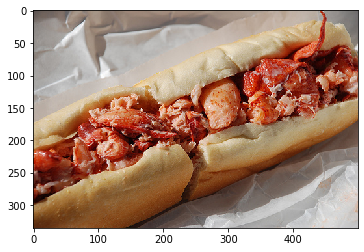

example 161 (index: 1016744)
label: trombone, prob: 0.9922085404396057, predicted_label: French_horn
n04487394_17698.JPEG


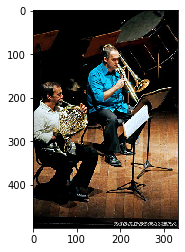

example 162 (index: 247380)
label: clumber, prob: 0.9943699240684509, predicted_label: cocker_spaniel
n02101556_8875.JPEG


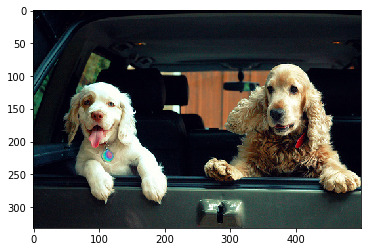

example 163 (index: 142339)
label: assault_rifle, prob: 0.7937594652175903, predicted_label: rifle
n02749479_3166.JPEG


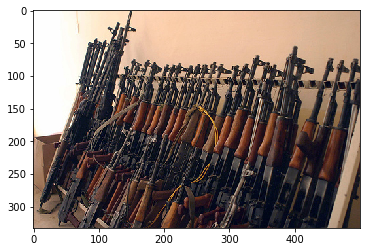

example 164 (index: 1092206)
label: lemon, prob: 0.7764339447021484, predicted_label: orange
n07749582_20019.JPEG


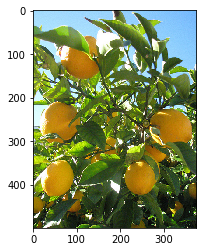

example 165 (index: 905003)
label: velvet, prob: 0.9971867203712463, predicted_label: theater_curtain
n04525038_4213.JPEG


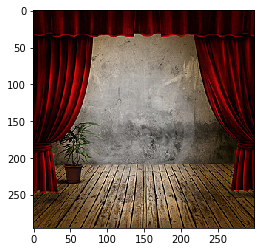

example 166 (index: 607639)
label: tench, prob: 0.9773563742637634, predicted_label: barracouta
n01440764_7492.JPEG


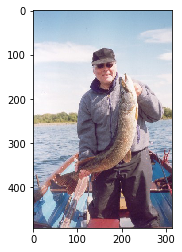

example 167 (index: 243201)
label: bell_cote, prob: 0.6585447192192078, predicted_label: chime
n02825657_11575.JPEG


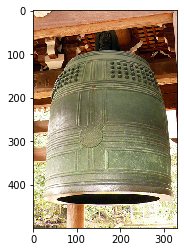

example 168 (index: 385481)
label: grand_piano, prob: 0.9780277609825134, predicted_label: upright
n03452741_2313.JPEG


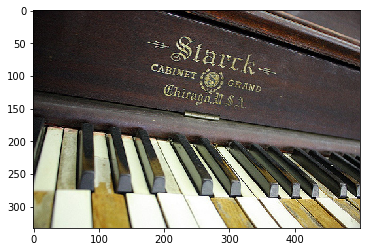

example 169 (index: 236233)
label: sliding_door, prob: 0.9667258858680725, predicted_label: shoji
n04239074_23530.JPEG


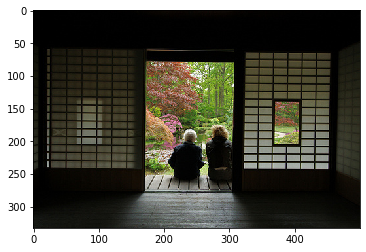

example 170 (index: 644112)
label: crib, prob: 0.5145425796508789, predicted_label: cradle
n03131574_20637.JPEG


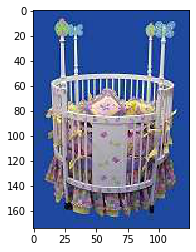

example 171 (index: 175981)
label: Border_terrier, prob: 0.9642601609230042, predicted_label: Brabancon_griffon
n02093754_4505.JPEG


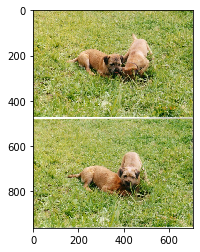

example 172 (index: 320228)
label: Eskimo_dog, prob: 0.998320460319519, predicted_label: dogsled
n02109961_5149.JPEG


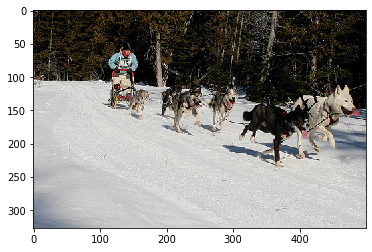

example 173 (index: 778634)
label: ground_beetle, prob: 0.9435608386993408, predicted_label: tiger_beetle
n02167151_5880.JPEG


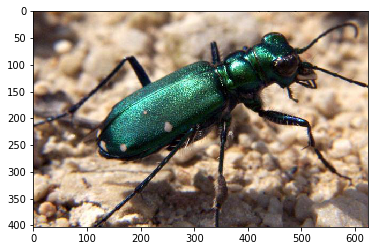

example 174 (index: 1111027)
label: moped, prob: 0.9349471926689148, predicted_label: motor_scooter
n03785016_1647.JPEG


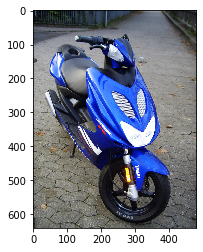

example 175 (index: 1108708)
label: hammerhead, prob: 0.9589110016822815, predicted_label: triceratops
n01494475_3125.JPEG


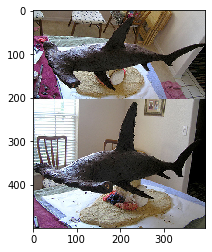

example 176 (index: 815876)
label: chime, prob: 0.9499191641807556, predicted_label: gong
n03017168_8703.JPEG


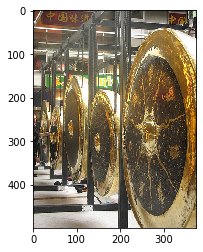

example 177 (index: 481365)
label: safe, prob: 0.9770466685295105, predicted_label: combination_lock
n04125021_11667.JPEG


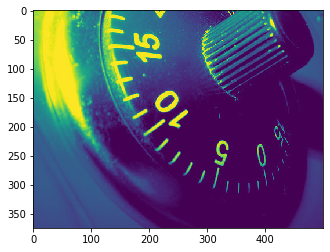

example 178 (index: 721227)
label: confectionery, prob: 0.9771549701690674, predicted_label: grocery_store
n03089624_13696.JPEG


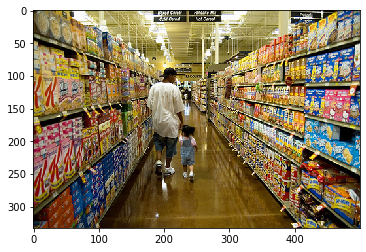

example 179 (index: 1195783)
label: power_drill, prob: 0.8146448731422424, predicted_label: carpenter's_kit
n03995372_10177.JPEG


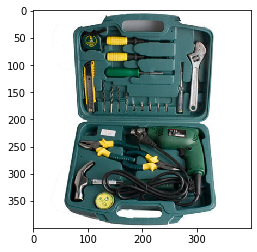

example 180 (index: 400225)
label: tiger_beetle, prob: 0.9981576800346375, predicted_label: ground_beetle
n02165105_3736.JPEG


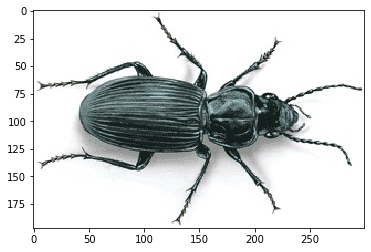

example 181 (index: 241803)
label: knee_pad, prob: 0.9944304823875427, predicted_label: volleyball
n03623198_4491.JPEG


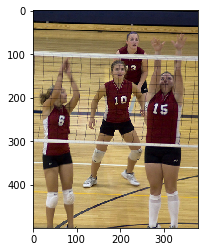

example 182 (index: 317772)
label: Dungeness_crab, prob: 0.8538232445716858, predicted_label: bucket
n01978287_2074.JPEG


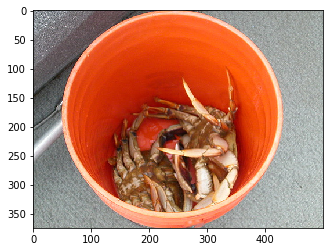

example 183 (index: 1259328)
label: rubber_eraser, prob: 0.9866650700569153, predicted_label: pencil_box
n04116512_8399.JPEG


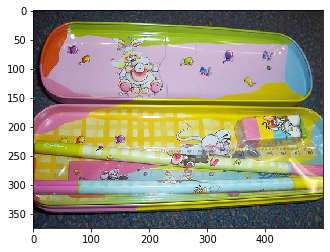

example 184 (index: 633238)
label: cardoon, prob: 0.9913812279701233, predicted_label: artichoke
n07730033_17449.JPEG


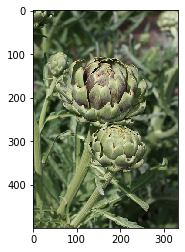

example 185 (index: 220990)
label: four-poster, prob: 0.843388020992279, predicted_label: mosquito_net
n03388549_489.JPEG


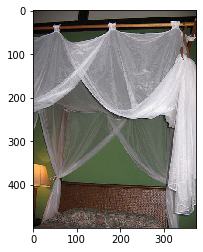

example 186 (index: 13059)
label: nail, prob: 0.7572402358055115, predicted_label: screw
n03804744_8152.JPEG


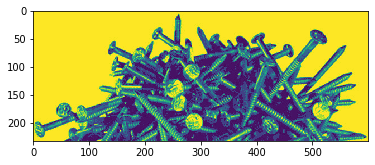

example 187 (index: 967914)
label: polecat, prob: 0.9368366003036499, predicted_label: black-footed_ferret
n02443114_2957.JPEG


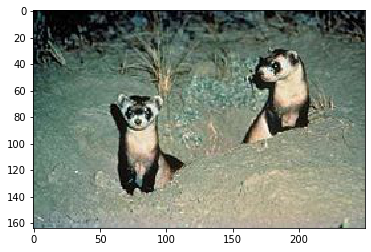

example 188 (index: 847784)
label: red_fox, prob: 0.8754093647003174, predicted_label: Arctic_fox
n02119022_11196.JPEG


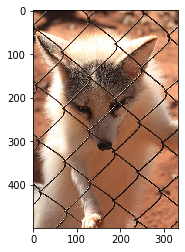

example 189 (index: 28924)
label: giant_schnauzer, prob: 0.9358542561531067, predicted_label: standard_schnauzer
n02097130_5252.JPEG


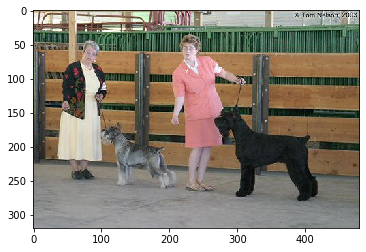

example 190 (index: 657056)
label: spatula, prob: 0.991076648235321, predicted_label: dishwasher
n04270147_10107.JPEG


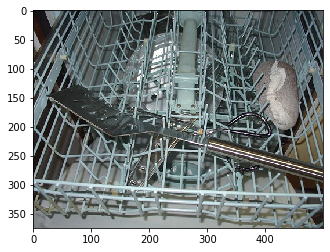

example 191 (index: 405251)
label: plate_rack, prob: 0.8306365609169006, predicted_label: stretcher
n03961711_21927.JPEG


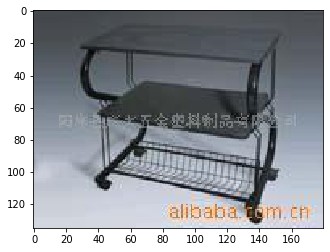

example 192 (index: 213272)
label: common_newt, prob: 0.9873501658439636, predicted_label: spotted_salamander
n01630670_6363.JPEG


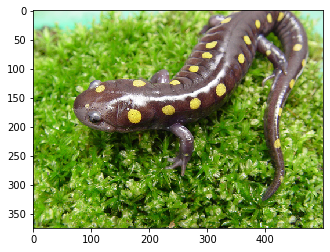

example 193 (index: 1084771)
label: shield, prob: 0.7848900556564331, predicted_label: cuirass
n04192698_12811.JPEG


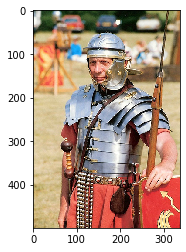

example 194 (index: 1239469)
label: cup, prob: 0.9985139966011047, predicted_label: espresso
n07930864_2067.JPEG


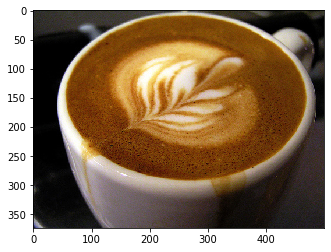

example 195 (index: 1003924)
label: crutch, prob: 0.8482077121734619, predicted_label: broom
n03141823_12311.JPEG


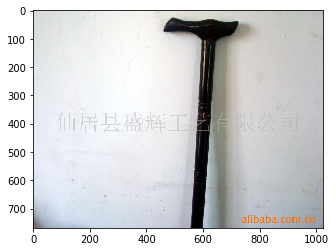

example 196 (index: 457751)
label: shoe_shop, prob: 0.9967315196990967, predicted_label: running_shoe
n04200800_19744.JPEG


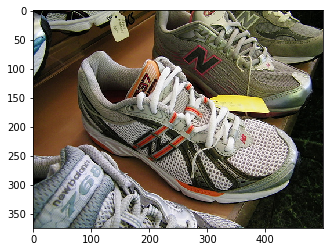

example 197 (index: 552302)
label: American_lobster, prob: 0.8023543357849121, predicted_label: Dungeness_crab
n01983481_3777.JPEG


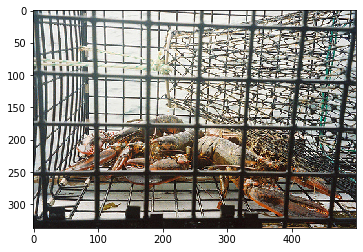

example 198 (index: 1208264)
label: obelisk, prob: 0.795563817024231, predicted_label: French_loaf
n03837869_2541.JPEG


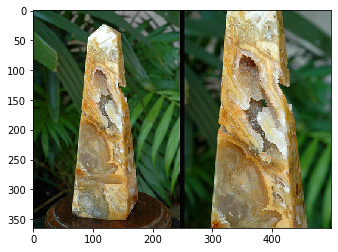

example 199 (index: 985062)
label: honeycomb, prob: 0.9888652563095093, predicted_label: apiary
n03530642_7219.JPEG


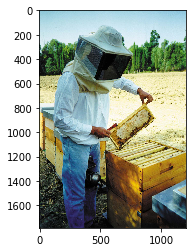

example 200 (index: 283304)
label: solar_dish, prob: 0.9644891619682312, predicted_label: radio_telescope
n04258138_500.JPEG


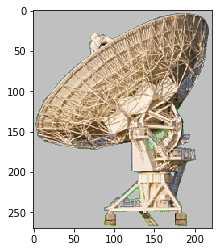

example 201 (index: 835575)
label: chain, prob: 0.6388091444969177, predicted_label: chain_mail
n02999410_14127.JPEG


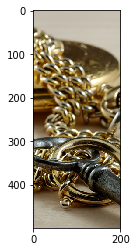

example 202 (index: 179084)
label: knee_pad, prob: 0.9952477812767029, predicted_label: volleyball
n03623198_565.JPEG


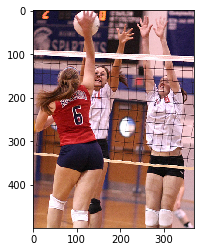

example 203 (index: 878863)
label: Dutch_oven, prob: 0.994571328163147, predicted_label: Crock_Pot
n03259280_5755.JPEG


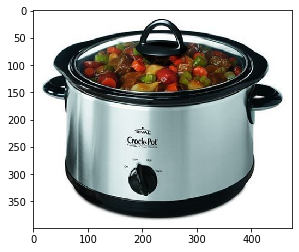

example 204 (index: 724736)
label: oscilloscope, prob: 0.9713808298110962, predicted_label: hand-held_computer
n03857828_8578.JPEG


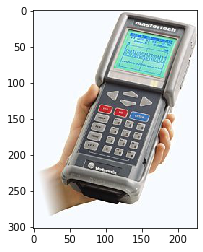

example 205 (index: 856908)
label: combination_lock, prob: 0.9821167588233948, predicted_label: padlock
n03075370_10238.JPEG


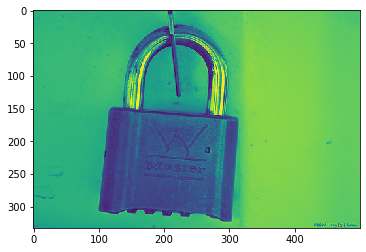

example 206 (index: 940813)
label: zucchini, prob: 0.9998763799667358, predicted_label: seat_belt
n07716358_19055.JPEG


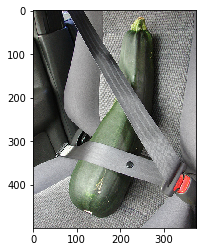

example 207 (index: 767521)
label: kelpie, prob: 0.9616122245788574, predicted_label: Labrador_retriever
n02105412_4675.JPEG


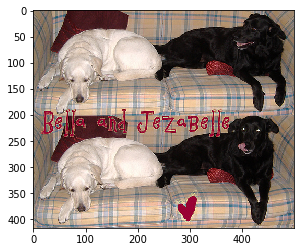

example 208 (index: 735361)
label: sombrero, prob: 0.9324490427970886, predicted_label: cowboy_hat
n04259630_11425.JPEG


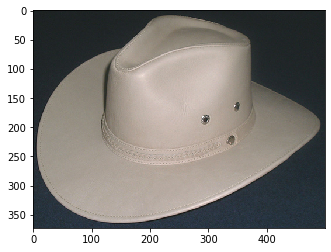

example 209 (index: 61103)
label: letter_opener, prob: 0.9458425045013428, predicted_label: scabbard
n03658185_9961.JPEG


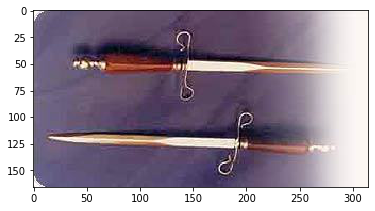

example 210 (index: 944587)
label: tape_player, prob: 0.9283384680747986, predicted_label: cassette
n04392985_10889.JPEG


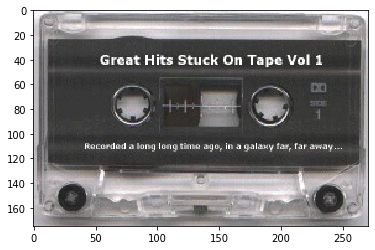

example 211 (index: 1136042)
label: gazelle, prob: 0.9390998482704163, predicted_label: impala
n02423022_5956.JPEG


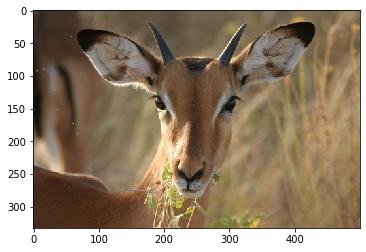

example 212 (index: 529757)
label: tractor, prob: 0.9052435159683228, predicted_label: thresher
n04465501_867.JPEG


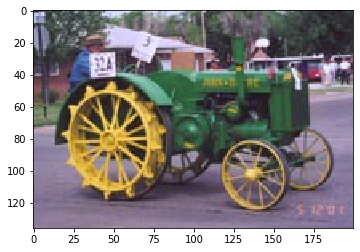

example 213 (index: 1051289)
label: whistle, prob: 0.49862366914749146, predicted_label: flute
n04579432_9765.JPEG


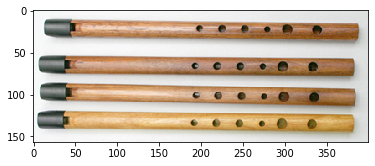

example 214 (index: 535629)
label: rhinoceros_beetle, prob: 0.9686101078987122, predicted_label: black_widow
n02174001_2152.JPEG


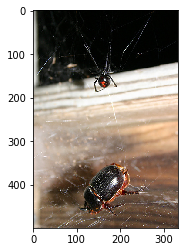

example 215 (index: 17165)
label: lotion, prob: 0.9201487898826599, predicted_label: soap_dispenser
n03690938_8674.JPEG


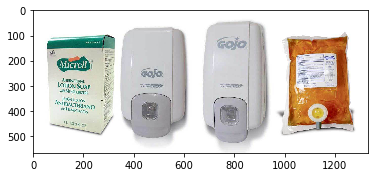

example 216 (index: 623840)
label: gong, prob: 0.827262818813324, predicted_label: drum
n03447721_24550.JPEG


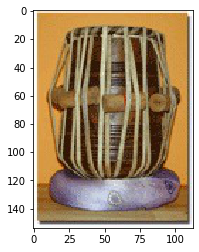

example 217 (index: 1092567)
label: sliding_door, prob: 0.9802733659744263, predicted_label: shoji
n04239074_11011.JPEG


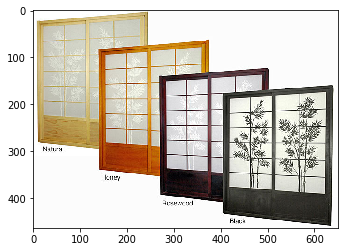

example 218 (index: 801052)
label: screwdriver, prob: 0.9836181402206421, predicted_label: corkscrew
n04154565_9990.JPEG


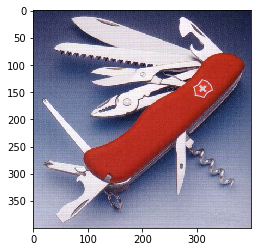

example 219 (index: 176629)
label: greenhouse, prob: 0.9614469408988953, predicted_label: hip
n03457902_3747.JPEG


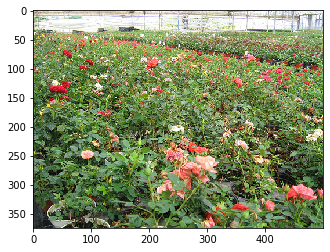

example 220 (index: 1274051)
label: pick, prob: 0.9151598811149597, predicted_label: electric_guitar
n03929660_73853.JPEG


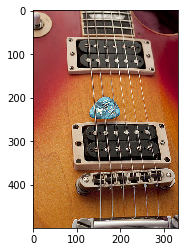

example 221 (index: 77791)
label: lens_cap, prob: 0.9431594014167786, predicted_label: loupe
n03657121_9077.JPEG


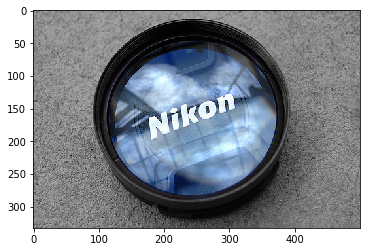

example 222 (index: 918916)
label: ram, prob: 0.9825552701950073, predicted_label: hog
n02412080_10833.JPEG


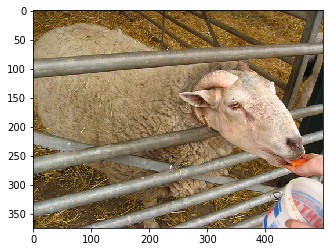

example 223 (index: 1271531)
label: loggerhead, prob: 0.9992558360099792, predicted_label: leatherback_turtle
n01664065_31648.JPEG


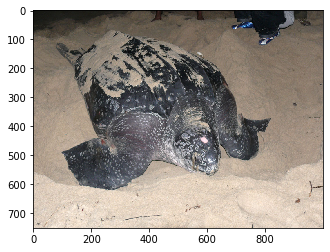

example 224 (index: 787635)
label: toilet_seat, prob: 0.9746316075325012, predicted_label: neck_brace
n04447861_6174.JPEG


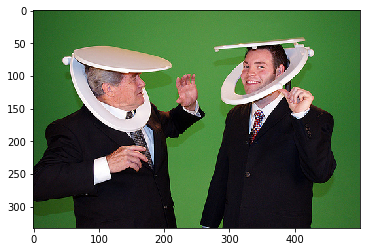

example 225 (index: 865838)
label: digital_clock, prob: 0.8926001787185669, predicted_label: stopwatch
n03196217_5823.JPEG


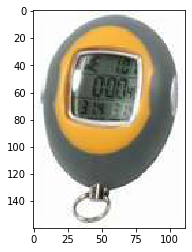

example 226 (index: 260074)
label: lotion, prob: 0.9844729900360107, predicted_label: sunscreen
n03690938_3564.JPEG


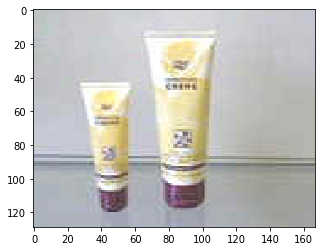

example 227 (index: 153772)
label: clog, prob: 0.9167999625205994, predicted_label: shoe_shop
n03047690_39051.JPEG


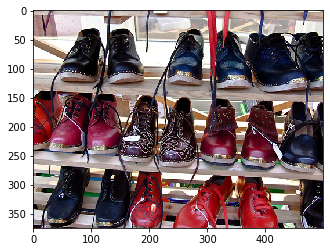

example 228 (index: 311617)
label: ladle, prob: 0.5352277755737305, predicted_label: spatula
n03633091_20591.JPEG


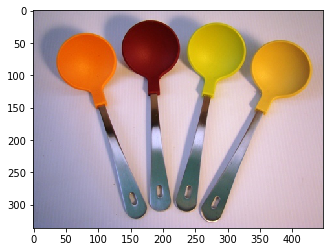

example 229 (index: 975182)
label: agama, prob: 0.9926630854606628, predicted_label: African_chameleon
n01687978_8959.JPEG


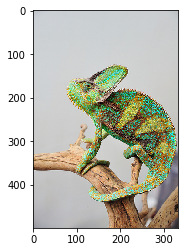

example 230 (index: 989039)
label: tape_player, prob: 0.995731770992279, predicted_label: cassette
n04392985_1626.JPEG


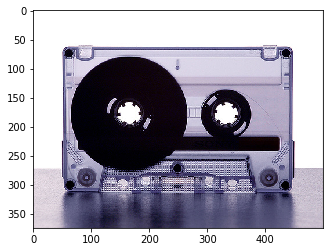

example 231 (index: 494725)
label: espresso_maker, prob: 0.9328141808509827, predicted_label: coffeepot
n03297495_6785.JPEG


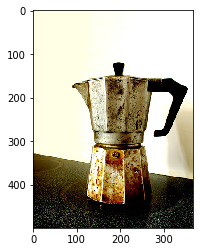

example 232 (index: 267036)
label: wooden_spoon, prob: 0.9849525690078735, predicted_label: spatula
n04597913_3787.JPEG


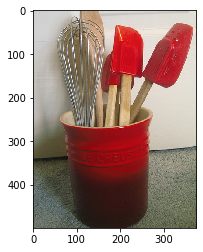

example 233 (index: 952665)
label: nail, prob: 0.9897696375846863, predicted_label: screw
n03804744_12576.JPEG


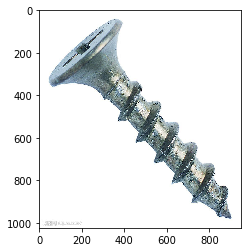

example 234 (index: 149736)
label: worm_fence, prob: 0.9342527389526367, predicted_label: picket_fence
n04604644_10568.JPEG


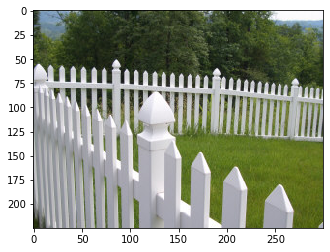

example 235 (index: 859344)
label: comic_book, prob: 0.7625772356987, predicted_label: grocery_store
n06596364_14510.JPEG


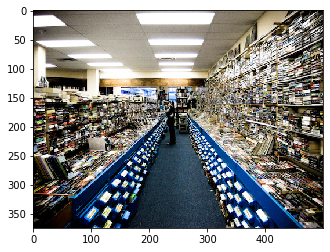

example 236 (index: 1204713)
label: handkerchief, prob: 0.8228847980499268, predicted_label: bath_towel
n03485794_61668.JPEG


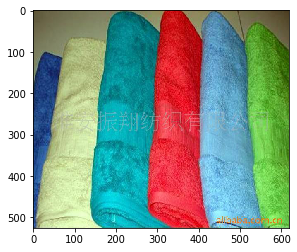

example 237 (index: 78494)
label: tennis_ball, prob: 0.9204671382904053, predicted_label: clumber
n04409515_2953.JPEG


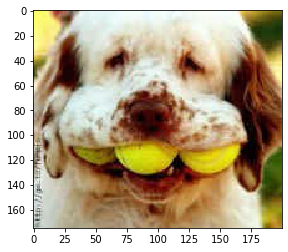

example 238 (index: 589664)
label: leopard, prob: 0.9736836552619934, predicted_label: snow_leopard
n02128385_15328.JPEG


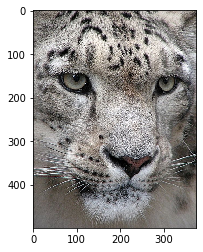

example 239 (index: 1139742)
label: shopping_basket, prob: 0.9550820589065552, predicted_label: shopping_cart
n04204238_2645.JPEG


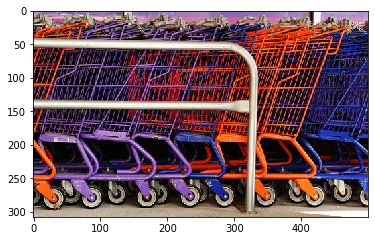

example 240 (index: 1109558)
label: groenendael, prob: 0.8938222527503967, predicted_label: affenpinscher
n02105056_2359.JPEG


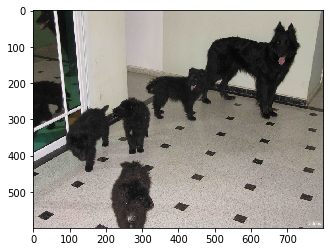

example 241 (index: 862381)
label: tennis_ball, prob: 0.9729301929473877, predicted_label: racket
n04409515_2123.JPEG


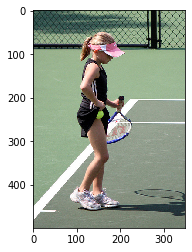

example 242 (index: 441090)
label: frying_pan, prob: 0.9836220741271973, predicted_label: wooden_spoon
n03400231_5508.JPEG


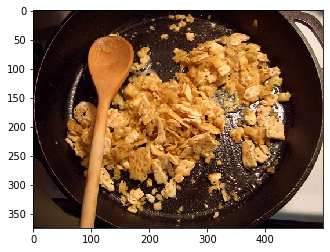

example 243 (index: 553888)
label: broccoli, prob: 0.9990566372871399, predicted_label: cauliflower
n07714990_15941.JPEG


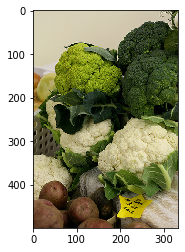

example 244 (index: 388261)
label: moped, prob: 0.8898594975471497, predicted_label: motor_scooter
n03785016_1742.JPEG


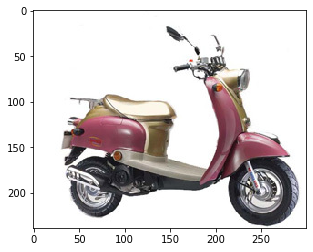

example 245 (index: 939079)
label: wine_bottle, prob: 0.8515854477882385, predicted_label: beer_bottle
n04591713_2808.JPEG


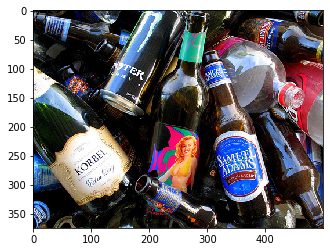

example 246 (index: 444912)
label: Chihuahua, prob: 0.9886661767959595, predicted_label: miniature_pinscher
n02085620_5477.JPEG


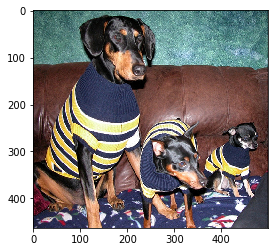

example 247 (index: 226393)
label: pole, prob: 0.9861574172973633, predicted_label: totem_pole
n03976657_23622.JPEG


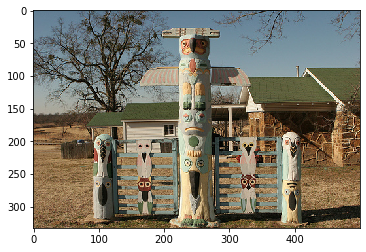

example 248 (index: 616908)
label: hamper, prob: 0.9397279620170593, predicted_label: shopping_basket
n03482405_16201.JPEG


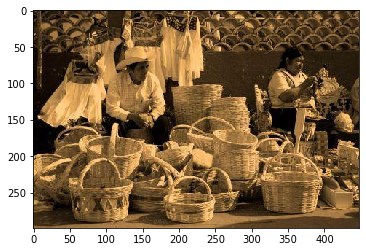

example 249 (index: 882418)
label: nipple, prob: 0.9416414499282837, predicted_label: pill_bottle
n03825788_19908.JPEG


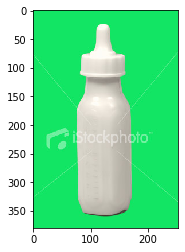

example 250 (index: 390532)
label: redshank, prob: 0.9730136394500732, predicted_label: stone_wall
n02028035_27496.JPEG


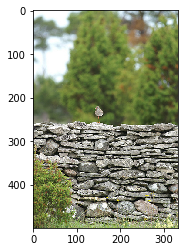

example 251 (index: 207567)
label: spatula, prob: 0.9096840023994446, predicted_label: frying_pan
n04270147_16520.JPEG


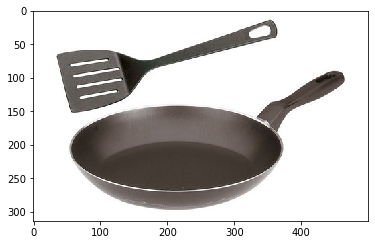

example 252 (index: 1022668)
label: poncho, prob: 0.9971502423286438, predicted_label: cloak
n03980874_4687.JPEG


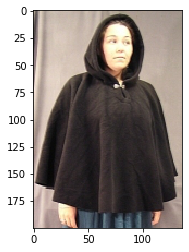

example 253 (index: 676115)
label: magnetic_compass, prob: 0.9974753260612488, predicted_label: sundial
n03706229_5474.JPEG


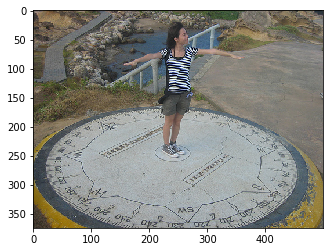

example 254 (index: 13618)
label: barbell, prob: 0.8747486472129822, predicted_label: dumbbell
n02790996_2579.JPEG


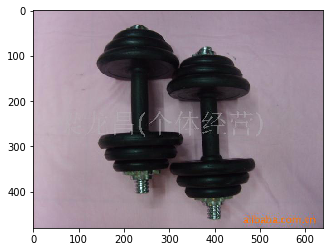

example 255 (index: 1001496)
label: dowitcher, prob: 0.8894248008728027, predicted_label: red-backed_sandpiper
n02033041_8866.JPEG


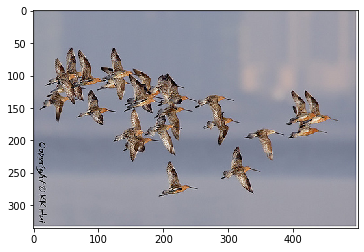

example 256 (index: 143882)
label: nipple, prob: 0.97499018907547, predicted_label: pill_bottle
n03825788_2122.JPEG


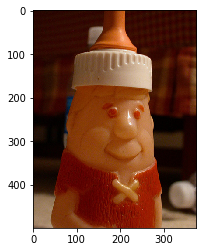

example 257 (index: 462764)
label: paper_towel, prob: 0.5890040397644043, predicted_label: toilet_tissue
n03887697_2069.JPEG


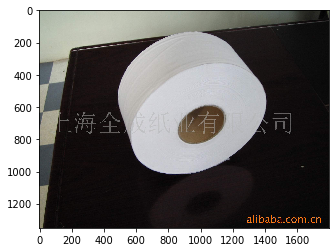

example 258 (index: 566473)
label: purse, prob: 0.654276430606842, predicted_label: apron
n04026417_1644.JPEG


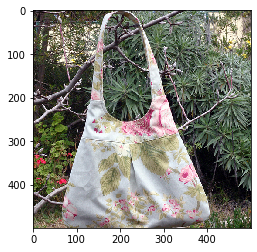

example 259 (index: 1113031)
label: chocolate_sauce, prob: 0.9970638155937195, predicted_label: trifle
n07836838_11188.JPEG


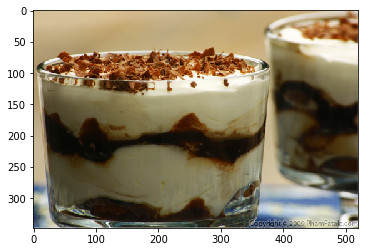

example 260 (index: 635543)
label: espresso_maker, prob: 0.8790242671966553, predicted_label: coffeepot
n03297495_25114.JPEG


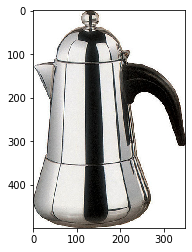

example 261 (index: 953415)
label: pole, prob: 0.9066776633262634, predicted_label: totem_pole
n03976657_24124.JPEG


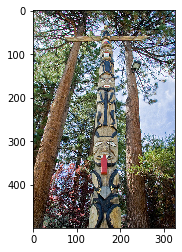

example 262 (index: 1024503)
label: trilobite, prob: 0.9203486442565918, predicted_label: centipede
n01768244_4526.JPEG


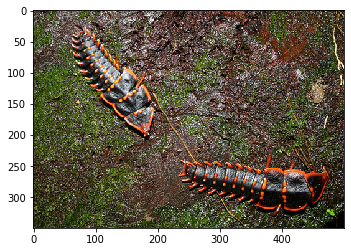

example 263 (index: 538989)
label: chimpanzee, prob: 0.9884976744651794, predicted_label: siamang
n02481823_8163.JPEG


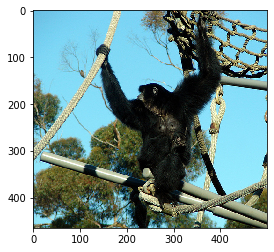

example 264 (index: 964242)
label: vault, prob: 0.9005463123321533, predicted_label: dome
n04523525_11909.JPEG


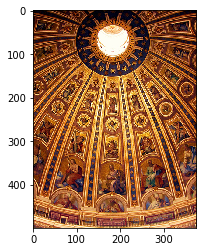

example 265 (index: 1000727)
label: shovel, prob: 0.6443953514099121, predicted_label: swab
n04208210_3110.JPEG


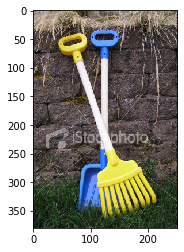

example 266 (index: 159745)
label: ground_beetle, prob: 0.9120532870292664, predicted_label: tiger_beetle
n02167151_8521.JPEG


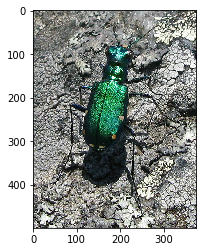

example 267 (index: 154015)
label: lotion, prob: 0.8456339240074158, predicted_label: soap_dispenser
n03690938_6199.JPEG


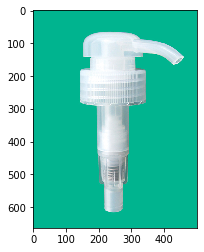

example 268 (index: 1079631)
label: spaghetti_squash, prob: 0.9977720975875854, predicted_label: acorn_squash
n07716906_6321.JPEG


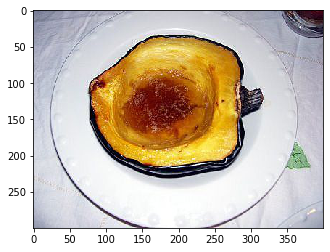

example 269 (index: 1023024)
label: lampshade, prob: 0.9999730587005615, predicted_label: jellyfish
n03637318_15999.JPEG


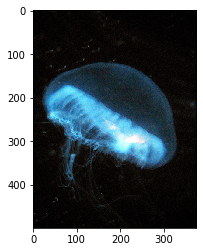

example 270 (index: 1003038)
label: tiger_shark, prob: 0.9918124675750732, predicted_label: great_white_shark
n01491361_11643.JPEG


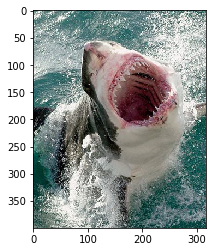

example 271 (index: 472879)
label: hand_blower, prob: 0.3763740658760071, predicted_label: hand_blower
n03483316_28047.JPEG


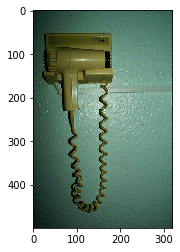

example 272 (index: 1118774)
label: shovel, prob: 0.9947770833969116, predicted_label: barrow
n04208210_22783.JPEG


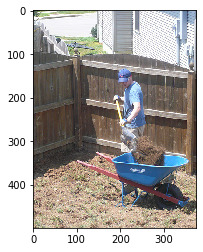

example 273 (index: 865591)
label: mask, prob: 0.9891520142555237, predicted_label: ski_mask
n03724870_21077.JPEG


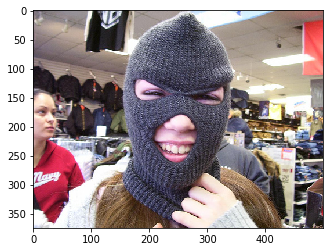

example 274 (index: 574218)
label: bloodhound, prob: 0.740607738494873, predicted_label: English_foxhound
n02088466_12476.JPEG


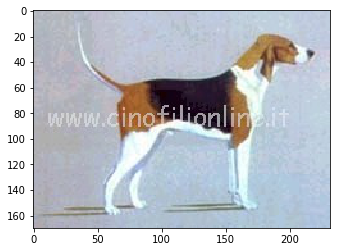

example 275 (index: 429583)
label: loudspeaker, prob: 0.8771809339523315, predicted_label: radiator
n03691459_4817.JPEG


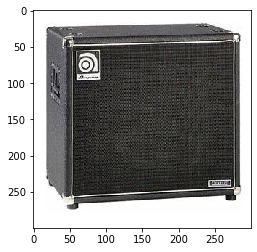

example 276 (index: 861791)
label: pole, prob: 0.8734238743782043, predicted_label: totem_pole
n03976657_4399.JPEG


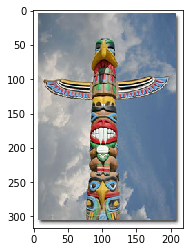

example 277 (index: 624386)
label: goblet, prob: 0.9933943152427673, predicted_label: beer_glass
n03443371_2378.JPEG


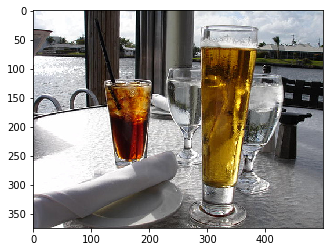

example 278 (index: 1088589)
label: running_shoe, prob: 0.9871475696563721, predicted_label: running_shoe
n04120489_1404.JPEG


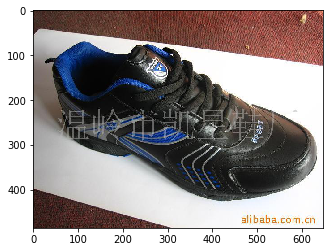

example 279 (index: 105587)
label: gong, prob: 0.9733926057815552, predicted_label: drum
n03447721_21865.JPEG


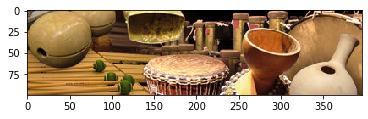

example 280 (index: 52539)
label: shopping_basket, prob: 0.627932608127594, predicted_label: backpack
n04204238_10611.JPEG


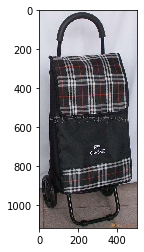

example 281 (index: 818784)
label: printer, prob: 0.9616085886955261, predicted_label: photocopier
n04004767_182.JPEG


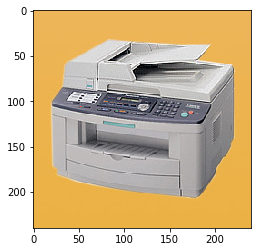

example 282 (index: 499220)
label: tennis_ball, prob: 0.9791638255119324, predicted_label: racket
n04409515_5756.JPEG


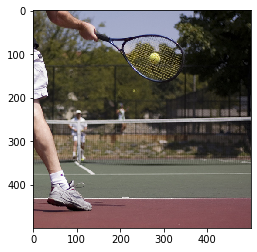

example 283 (index: 516521)
label: water_bottle, prob: 0.5899854898452759, predicted_label: pop_bottle
n04557648_10602.JPEG


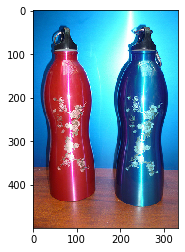

example 284 (index: 1072401)
label: cuirass, prob: 0.9732165932655334, predicted_label: breastplate
n03146219_20551.JPEG


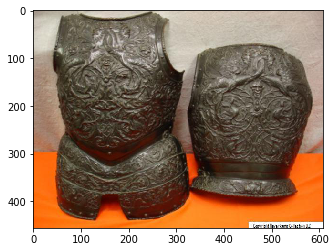

example 285 (index: 927612)
label: neck_brace, prob: 0.9834843277931213, predicted_label: crash_helmet
n03814639_2244.JPEG


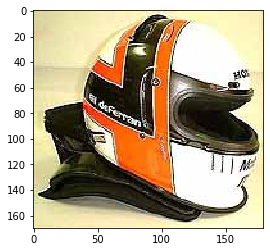

example 286 (index: 1154970)
label: marimba, prob: 0.6861724853515625, predicted_label: cowboy_hat
n03721384_34797.JPEG


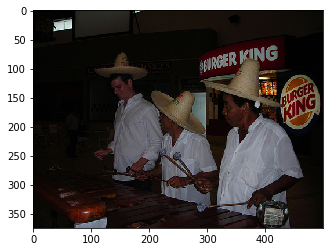

example 287 (index: 1021608)
label: pitcher, prob: 0.9517473578453064, predicted_label: water_jug
n03950228_12094.JPEG


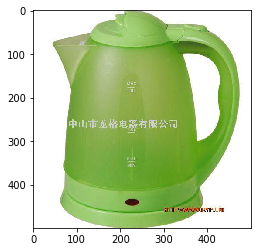

example 288 (index: 569637)
label: chain_mail, prob: 0.9975455403327942, predicted_label: shield
n03000247_19385.JPEG


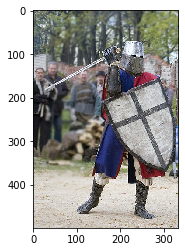

example 289 (index: 355648)
label: sunglass, prob: 0.9813997745513916, predicted_label: bathing_cap
n04355933_2340.JPEG


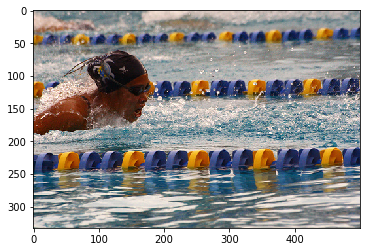

example 290 (index: 525648)
label: screwdriver, prob: 0.9672331809997559, predicted_label: power_drill
n04154565_16943.JPEG


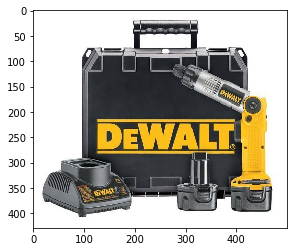

example 291 (index: 1129539)
label: goldfinch, prob: 0.9804742336273193, predicted_label: house_finch
n01531178_37595.JPEG


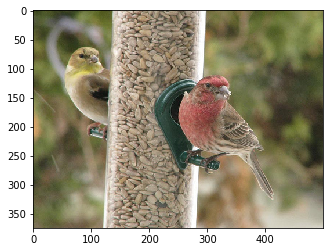

example 292 (index: 483765)
label: howler_monkey, prob: 0.9229941964149475, predicted_label: siamang
n02492660_9754.JPEG


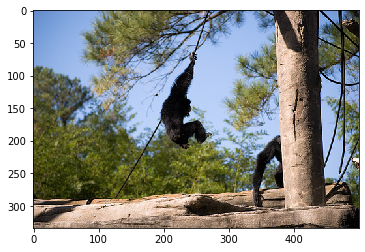

example 293 (index: 963761)
label: Irish_terrier, prob: 0.9291834831237793, predicted_label: soft-coated_wheaten_terrier
n02093991_3071.JPEG


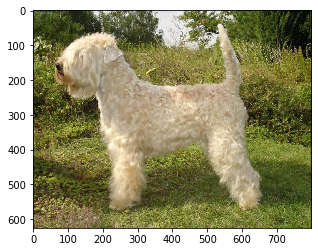

example 294 (index: 530967)
label: doormat, prob: 0.9995477795600891, predicted_label: magpie
n03223299_6897.JPEG


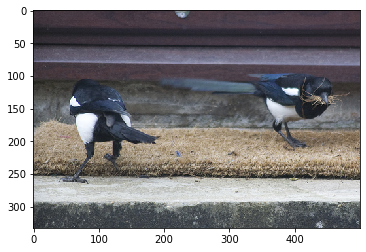

example 295 (index: 1106126)
label: hook, prob: 0.9962735176086426, predicted_label: rotisserie
n03532672_26758.JPEG


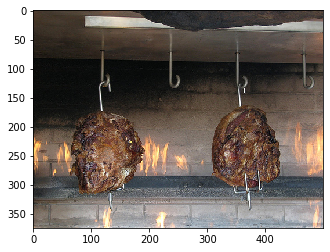

example 296 (index: 788290)
label: tape_player, prob: 0.9741736054420471, predicted_label: cassette_player
n04392985_11035.JPEG


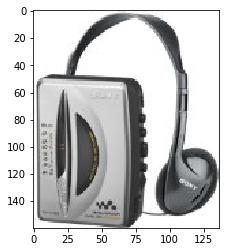

example 297 (index: 363188)
label: prairie_chicken, prob: 0.9953600764274597, predicted_label: ruffed_grouse
n01798484_9116.JPEG


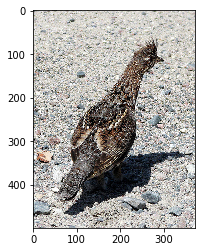

example 298 (index: 213940)
label: palace, prob: 0.6985900402069092, predicted_label: palace
n03877845_454.JPEG


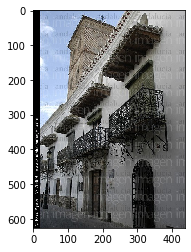

example 299 (index: 785543)
label: Cardigan, prob: 0.9190443754196167, predicted_label: German_shepherd
n02113186_14965.JPEG


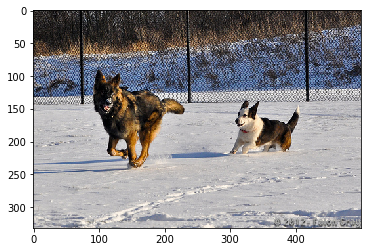

In [51]:
show_self_influence(trackin_train_self_influences, topk=300)

# Let us briefly interpret the results. 

The examples with top self-influence fall into a few categories, indicating different issues with the training data:

  1. Images have more than one type of object. For instance, the sombrero + maraca (example 0), the tennis ball + racket (example 1), **our favorite example the zucchini + seat belt (example 206)** etc. Here, the model predicts one of the objects (e.g. racket), whereas the label is the other object (e.g. tennis ball). This is a consequence of Imagenet's convention of having one one label per image, which results in ambiguity.
  2. Genuine mislabellings. For instance the dumbell that is labelled as a barbell (example 2), or the crock pot that is labelled as a hotpot (example 3). 
  3. Unique examples that are likely dissimilar from other examples of the same class. For instance, the oscilloscope (example 31), which only shows the visual of the waveform but not the scope itself. And similarly the digital watch (example 22), pencil sharpener (example 35), etc.  
  4. Images where there is genuine lack of information. Either the label or the prediction could be correct. Example, see the image of acoustic guitar/electric guitar (example 98). Only the fret of the guitar is visible. 